In [1]:
# Install required libraries for model and data handling
!pip install anomalib              # Anomaly detection utilities
!pip install lightning             # Lightweight PyTorch for model training
!pip install imgaug                # Image augmentation utilities
!pip install kornia                # Vision algorithms for PyTorch
!pip install timm                  # Pretrained models from Hugging Face
!pip install einops                # Tensor operations for flexible reshaping
!pip install FrEIA                 # Invertible neural networks framework
!pip install open_clip_torch       # CLIP models for text-image tasks

# Additional packages for data analysis and preprocessing
!pip install scikit-learn


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 5.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 486.6/486.6 kB 16.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 210.6/210.6 kB 16.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 624.4/624.4 kB 33.0 MB/s eta 0:00:00
  Created wheel for antlr4-python3-runtime: filename=antlr4_python3_runtime-4.9.3-py3-none-any.whl size=144554 sha256=3a2ca1644d31e804c08bbd6566e229495e86f39f6371063965429778db0a1dbf
  Stored in directory: /root/.cache/pip/wheels/12/93/dd/1f6a127edc45659556564c5730f6d4e300888f4bca2d4c5a88
Successfully built antlr4-python3-runtime
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 811.0/811.0 kB 13.6 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.2/43.2 kB 1.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel 

In this code, the following tasks are performed:

1. **Suppressing Warnings**: FutureWarnings related to Kornia are suppressed to avoid unnecessary output during execution.
  
2. **Imports**: Essential libraries are imported, including:
   - PyTorch for image transformations.
   - Anomalib for anomaly detection.
   - scikit-learn for evaluation.
   - matplotlib for plotting.

3. **Image Transformation Pipeline**: A basic transformation pipeline is defined to:
   - Resize images to 256x256.
   - Convert them to tensors.
   - Normalize them using ImageNet mean and standard deviation values.

4. **Dataset and Model Setup**: 
   - Anomalib’s `MVTec` dataset is used for anomaly detection.
   - The `Engine` from Anomalib is imported for training and evaluation.
   - The `EfficientAd` model is used for anomaly detection.
   - Additionally, tools for k-nearest neighbors (to find similar images) and metrics like ROC curves are also imported for model evaluation.

This code sets up the necessary environment and prepares the image transformation pipeline for further anomaly detection tasks.


In [5]:
import warnings

# Suppress specific FutureWarning from Kornia
warnings.filterwarnings("ignore", category=FutureWarning, message="`torch.cuda.amp.custom_fwd")

# Import required libraries
import os
import torch
from torchvision import transforms  # PyTorch image transformations

# Define a basic transform pipeline
image_transform = transforms.Compose([
    transforms.Resize((256, 256)),  # Resize images to a consistent size
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Importing modules from Anomalib and other required libraries
from anomalib.data import MVTec       # Dataset for anomaly detection
from anomalib.engine import Engine    # Model engine for training and evaluation
from anomalib.models import EfficientAd  # Efficient anomaly detection model
from sklearn.neighbors import NearestNeighbors  # For k-nearest neighbors
from sklearn.metrics import roc_curve, auc      # Evaluation metrics
import matplotlib.pyplot as plt                 # For plotting
import numpy as np                              # Array operations

This code evaluates the performance of the PatchCore anomaly detection model on different categories of the MVTec AD dataset. It loads the dataset for categories like "tile," "leather," and "grid," and trains the model using a pre-trained configuration. The model performs anomaly detection on test images, and the AUROC (Area Under the ROC Curve) score is calculated to assess the model’s performance. The code then prints the AUROC score for each category and computes the average AUROC across all categories. The primary focus is on evaluating anomaly detection across various object categories using the PatchCore model.

In [6]:
from anomalib.models import EfficientAd, Patchcore
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Define evaluation function for anomaly detection across categories
def evaluate_category(category_name):
    # Initialize dataset for specific category
    data_module = MVTec(
        category=category_name,
        train_batch_size=1,
        eval_batch_size=1,
        image_size=(128, 128),  # Set image size
        num_workers=3           # Number of workers for data loading
    )
    data_module.prepare_data()
    data_module.setup()

    # Set up dataloaders
    train_loader = data_module.train_dataloader()
    test_loader = data_module.test_dataloader()

    print(f"Training sample size for '{category_name}': {len(train_loader.dataset)}")
    print(f"Testing sample size for '{category_name}': {len(test_loader.dataset)}")

    # Initialize model and engine
    model = Patchcore(pre_trained=True, coreset_sampling_ratio=0.05).to(device)
    engine = Engine(
        task="segmentation",
        normalization="min_max",
        threshold="F1AdaptiveThreshold",
    )

    # Train and evaluate the model
    engine.fit(model=model, datamodule=data_module)
    test_results = engine.test(model=model, datamodule=data_module)

    # Retrieve AUROC score if available
    auroc_score = test_results[0].get("image_AUROC", None)
    return auroc_score

# Categories to evaluate
categories = ["tile", "leather", "grid"]
auroc_scores = {}

# Run evaluation for each category and store AUROC scores
for category in categories:
    print(f"\nEvaluating category: {category}")
    score = evaluate_category(category)
    if score is not None:
        auroc_scores[category] = score

# Print results if scores are available
if auroc_scores:
    for category, score in auroc_scores.items():
        print(f"AUROC for {category}: {score:.4f}")

    # Calculate average AUROC
    avg_auroc = sum(auroc_scores.values()) / len(auroc_scores)
    print(f"\nAverage AUROC across categories: {avg_auroc:.4f}")


Evaluating category: tile


mvtec: 5.26GB [02:55, 30.1MB/s]                               


Training sample size for 'tile': 230
Testing sample size for 'tile': 117


model.safetensors:   0%|          | 0.00/276M [00:00<?, ?B/s]

INFO: GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO: HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
/opt/conda/lib/python3.10/site-packages/lightning/pytorch/core/optimizer.py:182: `LightningModule.configure_optimizers` returned `None`, this fit will run with no optimizer
INFO: 
  | Name                  | Type                     | Params | Mode 
---------------------------------------------------------------------------
0 | model                 | PatchcoreModel           | 24.9 M | train
1 | _transform            | Compose                  | 0      | train
2 | normalization_metrics | MetricCollection         | 0      | train
3 | image_threshold       | F1AdaptiveThreshold      | 0      | train
4 | pixel_threshold       | F1AdaptiveThreshold      | 0      | train
5 | image_metrics         | AnomalibMetricCollection | 0      | train
6 | pixel_metrics         | AnomalibMetricCollection | 0      | train


Training: |          | 0/? [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/lightning/pytorch/loops/optimization/automatic.py:132: `training_step` returned `None`. If this was on purpose, ignore this warning...


Validation: |          | 0/? [00:00<?, ?it/s]



Selecting Coreset Indices.:   0%|          | 0/2254 [00:00<?, ?it/s]

Selecting Coreset Indices.:   0%|          | 1/2254 [00:00<04:19,  8.69it/s]

Selecting Coreset Indices.:   3%|▎         | 61/2254 [00:00<00:06, 335.35it/s]

Selecting Coreset Indices.:   6%|▋         | 143/2254 [00:00<00:03, 547.12it/s]

Selecting Coreset Indices.:  10%|▉         | 225/2254 [00:00<00:03, 650.30it/s]

Selecting Coreset Indices.:  14%|█▍        | 310/2254 [00:00<00:02, 720.31it/s]

Selecting Coreset Indices.:  18%|█▊        | 396/2254 [00:00<00:02, 764.75it/s]

Selecting Coreset Indices.:  21%|██▏       | 479/2254 [00:00<00:02, 783.87it/s]

Selecting Coreset Indices.:  25%|██▍       | 562/2254 [00:00<00:02, 798.10it/s]

Selecting Coreset Indices.:  29%|██▊       | 646/2254 [00:00<00:01, 809.77it/s]

Selecting Coreset Indices.:  32%|███▏      | 732/2254 [00:01<00:01, 824.21it/s]

Selecting Coreset Indices.:  36%|███▋      | 819/2254 [00:01<00:01, 836.24it/s]

Selecting Coreset Indices.:  40%|████    

Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│        image_AUROC        │    0.9772727489471436     │
│       image_F1Score       │    0.9580838084220886     │
│        pixel_AUROC        │    0.9188004732131958     │
│       pixel_F1Score       │    0.5473781228065491     │
└───────────────────────────┴───────────────────────────┘


Evaluating category: leather
Training sample size for 'leather': 245
Testing sample size for 'leather': 124


INFO: GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO: HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
/opt/conda/lib/python3.10/site-packages/lightning/pytorch/core/optimizer.py:182: `LightningModule.configure_optimizers` returned `None`, this fit will run with no optimizer
INFO: 
  | Name                  | Type                     | Params | Mode 
---------------------------------------------------------------------------
0 | model                 | PatchcoreModel           | 24.9 M | train
1 | _transform            | Compose                  | 0      | train
2 | normalization_metrics | MetricCollection         | 0      | train
3 | image_threshold       | F1AdaptiveThreshold      | 0      | train
4 | pixel_threshold       | F1AdaptiveThreshold      | 0      | train
5 | image_metrics         | AnomalibMetricCollection | 0      | train
6 | pixel_metrics         | AnomalibMetricCollection | 0      | train


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]



Selecting Coreset Indices.:   0%|          | 0/2401 [00:00<?, ?it/s]

Selecting Coreset Indices.:   3%|▎         | 63/2401 [00:00<00:03, 627.98it/s]

Selecting Coreset Indices.:   6%|▌         | 135/2401 [00:00<00:03, 679.23it/s]

Selecting Coreset Indices.:   9%|▉         | 213/2401 [00:00<00:03, 722.71it/s]

Selecting Coreset Indices.:  12%|█▏        | 295/2401 [00:00<00:02, 757.73it/s]

Selecting Coreset Indices.:  16%|█▌        | 376/2401 [00:00<00:02, 773.91it/s]

Selecting Coreset Indices.:  19%|█▉        | 457/2401 [00:00<00:02, 784.48it/s]

Selecting Coreset Indices.:  22%|██▏       | 538/2401 [00:00<00:02, 792.05it/s]

Selecting Coreset Indices.:  26%|██▌       | 619/2401 [00:00<00:02, 796.69it/s]

Selecting Coreset Indices.:  29%|██▉       | 700/2401 [00:00<00:02, 799.51it/s]

Selecting Coreset Indices.:  33%|███▎      | 782/2401 [00:01<00:02, 803.00it/s]

Selecting Coreset Indices.:  36%|███▌      | 863/2401 [00:01<00:01, 804.03it/s]

Selecting Coreset Indices.:  39%|███▉ 

Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│        image_AUROC        │            1.0            │
│       image_F1Score       │     0.994535505771637     │
│        pixel_AUROC        │    0.9794812798500061     │
│       pixel_F1Score       │    0.34816011786460876    │
└───────────────────────────┴───────────────────────────┘


Evaluating category: grid
Training sample size for 'grid': 264
Testing sample size for 'grid': 78


INFO: GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO: HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
/opt/conda/lib/python3.10/site-packages/lightning/pytorch/core/optimizer.py:182: `LightningModule.configure_optimizers` returned `None`, this fit will run with no optimizer
INFO: 
  | Name                  | Type                     | Params | Mode 
---------------------------------------------------------------------------
0 | model                 | PatchcoreModel           | 24.9 M | train
1 | _transform            | Compose                  | 0      | train
2 | normalization_metrics | MetricCollection         | 0      | train
3 | image_threshold       | F1AdaptiveThreshold      | 0      | train
4 | pixel_threshold       | F1AdaptiveThreshold      | 0      | train
5 | image_metrics         | AnomalibMetricCollection | 0      | train
6 | pixel_metrics         | AnomalibMetricCollection | 0      | train


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]



Selecting Coreset Indices.:   0%|          | 0/2587 [00:00<?, ?it/s]

Selecting Coreset Indices.:   2%|▏         | 62/2587 [00:00<00:04, 615.29it/s]

Selecting Coreset Indices.:   5%|▌         | 134/2587 [00:00<00:03, 675.94it/s]

Selecting Coreset Indices.:   8%|▊         | 210/2587 [00:00<00:03, 710.69it/s]

Selecting Coreset Indices.:  11%|█         | 286/2587 [00:00<00:03, 726.36it/s]

Selecting Coreset Indices.:  14%|█▍        | 362/2587 [00:00<00:03, 735.33it/s]

Selecting Coreset Indices.:  17%|█▋        | 438/2587 [00:00<00:02, 740.30it/s]

Selecting Coreset Indices.:  20%|█▉        | 513/2587 [00:00<00:02, 742.84it/s]

Selecting Coreset Indices.:  23%|██▎       | 588/2587 [00:00<00:02, 742.52it/s]

Selecting Coreset Indices.:  26%|██▌       | 663/2587 [00:00<00:02, 740.22it/s]

Selecting Coreset Indices.:  29%|██▊       | 738/2587 [00:01<00:02, 738.85it/s]

Selecting Coreset Indices.:  31%|███▏      | 813/2587 [00:01<00:02, 739.29it/s]

Selecting Coreset Indices.:  34%|███▍ 

Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│        image_AUROC        │    0.8629908561706543     │
│       image_F1Score       │    0.8983050584793091     │
│        pixel_AUROC        │    0.8858410716056824     │
│       pixel_F1Score       │    0.18243898451328278    │
└───────────────────────────┴───────────────────────────┘

AUROC for tile: 0.9773
AUROC for leather: 1.0000
AUROC for grid: 0.8630

Average AUROC across categories: 0.9468


This Python script is designed to evaluate an anomaly detection model (`EfficientAd`) from the `Anomalib` library on the MVTec dataset, which is often used for anomaly detection in images. Below is a breakdown of the key steps:

1. **Library Imports**: 
   - The script imports necessary libraries including `torch` (for deep learning), `MVTec` (from `Anomalib`), `Engine` (for model training), and `EfficientAd` (the chosen anomaly detection model).
   
2. **Device Setup**:
   - The device (`cuda` if available, otherwise `cpu`) is set for running the model on either a GPU or CPU, depending on hardware availability.

3. **Function Definition (`evaluate_category`)**:
   - This function performs the following steps:
     1. **Data Module Initialization**: The `MVTec` dataset is loaded for a specific category (like "tile", "leather", or "grid"), with a batch size of 1 and image resolution set to 256x256.
     2. **Model Initialization**: An `EfficientAd` model is instantiated with specific parameters (like learning rate and weight decay).
     3. **Training and Evaluation**: The model is trained and evaluated using the `Engine` class, which is set up for segmentation tasks. It uses F1 adaptive thresholding and min-max normalization during training.
     4. **AUROC Score Retrieval**: The model’s performance is evaluated, and the AUROC (Area Under the Receiver Operating Characteristic Curve) score is retrieved.

4. **Category Evaluation**:
   - The script defines a list of categories (`tile`, `leather`, `grid`) to evaluate. For each category, it runs the `evaluate_category` function and stores the AUROC scores in a dictionary.

5. **Results Output**:
   - After evaluating all the categories, the AUROC score for each category is printed, followed by the average AUROC score across all categories.



In [7]:
import os
import torch
from anomalib.models import EfficientAd
from anomalib.data import MVTec
from anomalib.engine import Engine

# Set the device for computation
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# Uncomment for debugging device info
# print(f"Using device: {device}")

# Disable rich text formatting if not needed
os.environ["RICH_DISABLE"] = "True"

# Define evaluation function for a given category
def evaluate_category(category_name):
    # Initialize the data module with given category
    data_module = MVTec(
        category=category_name,
        train_batch_size=1,
        eval_batch_size=1,
        image_size=(256, 256),  # Set image resolution
        num_workers=2
    )
    data_module.prepare_data()
    data_module.setup()

    # Dataloader setup
    train_loader = data_module.train_dataloader()
    test_loader = data_module.test_dataloader()

    print(f"Training samples in '{category_name}': {len(train_loader.dataset)}")
    print(f"Testing samples in '{category_name}': {len(test_loader.dataset)}")

    # Model initialization
    model = EfficientAd(
        teacher_out_channels=384,
        weight_decay=1e-05,
        lr=1e-4
    ).to(device)

    # Model training and evaluation engine
    engine = Engine(
        task="segmentation",
        normalization="min_max",
        threshold="F1AdaptiveThreshold",
        max_epochs=1,
    )

    # Train and evaluate the model on the data module
    engine.fit(model=model, datamodule=data_module)
    test_results = engine.test(model=model, datamodule=data_module)

    # Retrieve AUROC score if available
    auroc_score = test_results[0].get("image_AUROC", None)
    return auroc_score

# List of categories for evaluation
categories = ["tile", "leather", "grid"]
auroc_scores = {}

# Run evaluation for each category and store the AUROC scores
for category in categories:
    print(f"\nEvaluating category: {category}")
    score = evaluate_category(category)
    if score is not None:
        auroc_scores[category] = score

# Print AUROC results for each category if available
if auroc_scores:
    for category, score in auroc_scores.items():
        print(f"AUROC for {category}: {score:.4f}")

    # Calculate and display the average AUROC across categories
    avg_auroc = sum(auroc_scores.values()) / len(auroc_scores)
    print(f"\nAverage AUROC across categories: {avg_auroc:.4f}")


INFO: GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO: HPU available: False, using: 0 HPUs



Evaluating category: tile
Training samples in 'tile': 230
Testing samples in 'tile': 117


INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
INFO: 
  | Name                  | Type                     | Params | Mode 
---------------------------------------------------------------------------
0 | model                 | EfficientAdModel         | 8.1 M  | train
1 | _transform            | Compose                  | 0      | train
2 | normalization_metrics | MetricCollection         | 0      | train
3 | image_threshold       | F1AdaptiveThreshold      | 0      | train
4 | pixel_threshold       | F1AdaptiveThreshold      | 0      | train
5 | image_metrics         | AnomalibMetricCollection | 0      | train
6 | pixel_metrics         | AnomalibMetricCollection | 0      | train
---------------------------------------------------------------------------
8.1 M     Trainable params
0         Non-trainable params
8.1 M     Total params
32.235    Total estimated model params size (MB)
46        Modules in train mode
7         Modules in eval mode


Training: |          | 0/? [00:00<?, ?it/s]


efficientad_pretrained_weights.zip: 0.00B [00:00, ?B/s]
efficientad_pretrained_weights.zip:   0%|          | 8.19k/40.0M [00:00<22:21, 29.8kB/s]
efficientad_pretrained_weights.zip:  24%|██▍       | 9.62M/40.0M [00:00<00:00, 32.9MB/s]
efficientad_pretrained_weights.zip:  38%|███▊      | 15.0M/40.0M [00:00<00:00, 35.2MB/s]
efficientad_pretrained_weights.zip:  43%|████▎     | 17.1M/40.0M [00:00<00:00, 31.0MB/s]
efficientad_pretrained_weights.zip:  81%|████████  | 32.4M/40.0M [00:00<00:00, 67.0MB/s]
efficientad_pretrained_weights.zip:  87%|████████▋ | 34.6M/40.0M [00:00<00:00, 50.7MB/s]
efficientad_pretrained_weights.zip: 40.0MB [00:00, 41.6MB/s]                            
/opt/conda/lib/python3.10/site-packages/anomalib/models/image/efficient_ad/lightning_model.py:98: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during 

Validation: |          | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles: 100%|██████████| 117/117 [00:03<00:00, 36.72it/s]
INFO: `Trainer.fit` stopped: `max_epochs=1` reached.
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│        image_AUROC        │    0.9383116960525513     │
│       image_F1Score       │    0.9050279259681702     │
│        pixel_AUROC        │    0.7720263600349426     │
│       pixel_F1Score       │    0.5319671034812927     │
└───────────────────────────┴───────────────────────────┘

INFO: GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO: HPU available: False, using: 0 HPUs



Evaluating category: leather
Training samples in 'leather': 245
Testing samples in 'leather': 124


INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
INFO: 
  | Name                  | Type                     | Params | Mode 
---------------------------------------------------------------------------
0 | model                 | EfficientAdModel         | 8.1 M  | train
1 | _transform            | Compose                  | 0      | train
2 | normalization_metrics | MetricCollection         | 0      | train
3 | image_threshold       | F1AdaptiveThreshold      | 0      | train
4 | pixel_threshold       | F1AdaptiveThreshold      | 0      | train
5 | image_metrics         | AnomalibMetricCollection | 0      | train
6 | pixel_metrics         | AnomalibMetricCollection | 0      | train
---------------------------------------------------------------------------
8.1 M     Trainable params
0         Non-trainable params
8.1 M     Total params
32.235    Total estimated model params size (MB)
46        Modules in train mode
7         Modules in eval mode


Training: |          | 0/? [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/anomalib/models/image/efficient_ad/lightning_model.py:98: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
/opt/conda/lib/python3.10/site-packages/torchv

Validation: |          | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles: 100%|██████████| 124/124 [00:04<00:00, 27.31it/s]
INFO: `Trainer.fit` stopped: `max_epochs=1` reached.
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│        image_AUROC        │    0.8940218091011047     │
│       image_F1Score       │     0.886227548122406     │
│        pixel_AUROC        │    0.9433205723762512     │
│       pixel_F1Score       │    0.45338982343673706    │
└───────────────────────────┴───────────────────────────┘

INFO: GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO: HPU available: False, using: 0 HPUs



Evaluating category: grid
Training samples in 'grid': 264
Testing samples in 'grid': 78


INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
INFO: 
  | Name                  | Type                     | Params | Mode 
---------------------------------------------------------------------------
0 | model                 | EfficientAdModel         | 8.1 M  | train
1 | _transform            | Compose                  | 0      | train
2 | normalization_metrics | MetricCollection         | 0      | train
3 | image_threshold       | F1AdaptiveThreshold      | 0      | train
4 | pixel_threshold       | F1AdaptiveThreshold      | 0      | train
5 | image_metrics         | AnomalibMetricCollection | 0      | train
6 | pixel_metrics         | AnomalibMetricCollection | 0      | train
---------------------------------------------------------------------------
8.1 M     Trainable params
0         Non-trainable params
8.1 M     Total params
32.235    Total estimated model params size (MB)
46        Modules in train mode
7         Modules in eval mode


Training: |          | 0/? [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/anomalib/models/image/efficient_ad/lightning_model.py:98: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
/opt/conda/lib/python3.10/site-packages/torchv

Validation: |          | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles: 100%|██████████| 78/78 [00:01<00:00, 41.00it/s]
INFO: `Trainer.fit` stopped: `max_epochs=1` reached.
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│        image_AUROC        │     0.969924807548523     │
│       image_F1Score       │    0.9482758641242981     │
│        pixel_AUROC        │    0.8418945670127869     │
│       pixel_F1Score       │    0.33026671409606934    │
└───────────────────────────┴───────────────────────────┘

AUROC for tile: 0.9383
AUROC for leather: 0.8940
AUROC for grid: 0.9699

Average AUROC across categories: 0.9341


This Python script is used to visualize key performance metrics (ROC Curve, Precision-Recall Curve, and F1 Score vs. Threshold) for anomaly detection models using simulated data. Here’s a breakdown of what the code does:

1. **Library Imports**: 
   - `matplotlib` for plotting the evaluation curves.
   - `sklearn.metrics` for calculating performance metrics like ROC and Precision-Recall curves.
   - `numpy` for handling the data and random number generation.

2. **Simulated Data**: 
   - A dictionary (`sample_data`) is defined with categories (`tile`, `leather`, `grid`), where each category has a pair of data:
     - **Actual Labels**: Binary values (0 or 1) indicating the ground truth (anomalous or not).
     - **Score Predictions**: Model's predicted scores, where higher values typically correspond to higher confidence in anomaly detection.

3. **Function Definition (`visualize_metrics`)**: 
   - This function takes `actual_labels`, `score_predictions`, and a `name` (category name) as inputs and performs the following steps:
     1. **ROC Curve**: The Receiver Operating Characteristic (ROC) curve is plotted, showing the trade-off between True Positive Rate and False Positive Rate. The Area Under the Curve (AUROC) is also displayed.
     2. **F1 Score vs. Threshold**: This curve is plotted to show how the F1 score varies with different decision thresholds. The optimal threshold that maximizes the F1 score is highlighted.
     3. **Precision-Recall Curve**: The Precision-Recall curve is plotted along with the average precision score (AP). The optimal threshold based on F1 score is also indicated.

4. **Metrics Plotting**: 
   - For each category in `sample_data`, the `visualize_metrics` function is called to generate and display the evaluation plots.



Plotting metrics for category 'tile'...


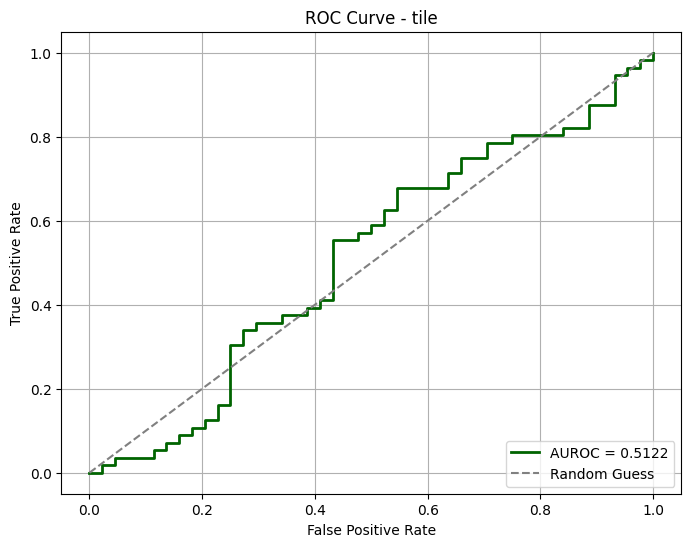

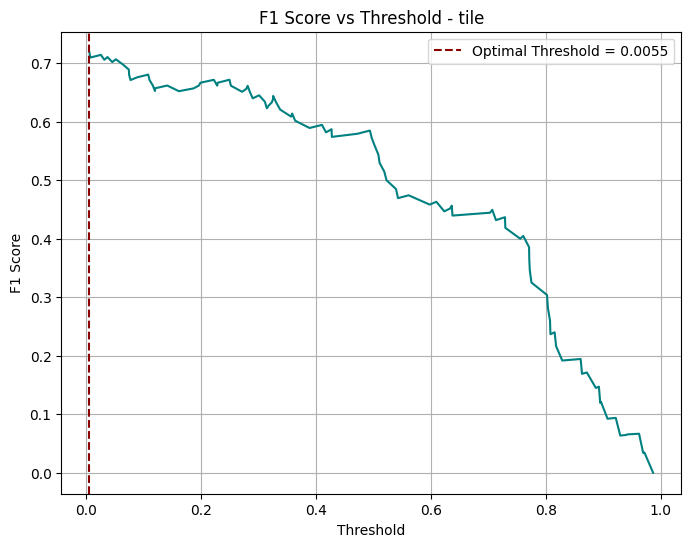

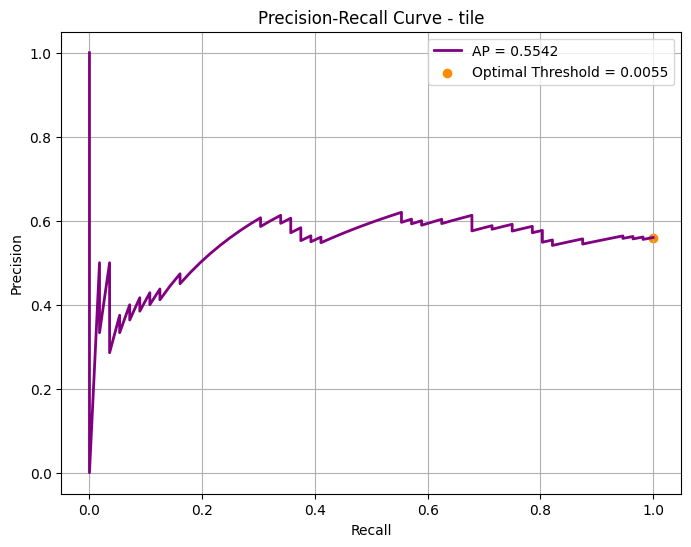

Plotting metrics for category 'leather'...


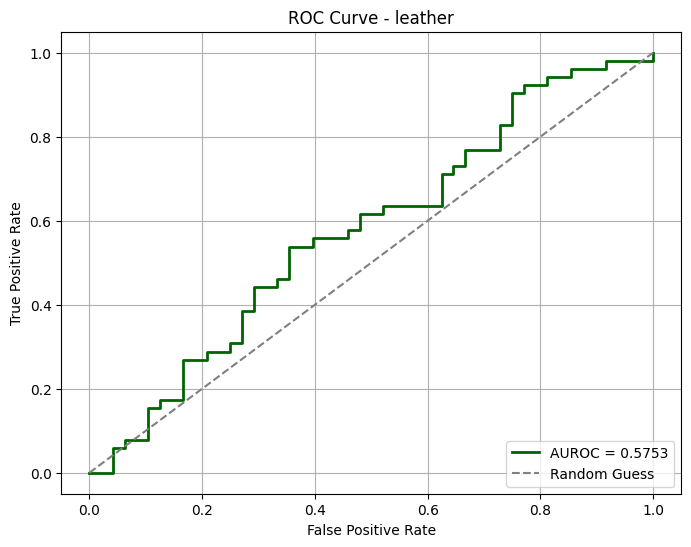

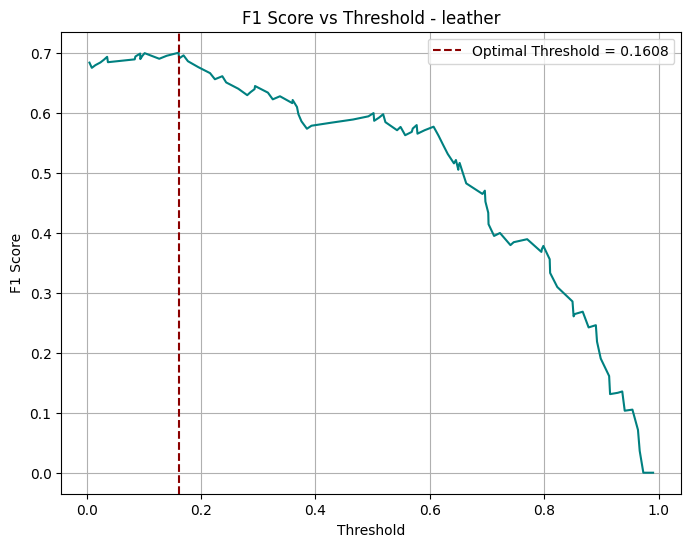

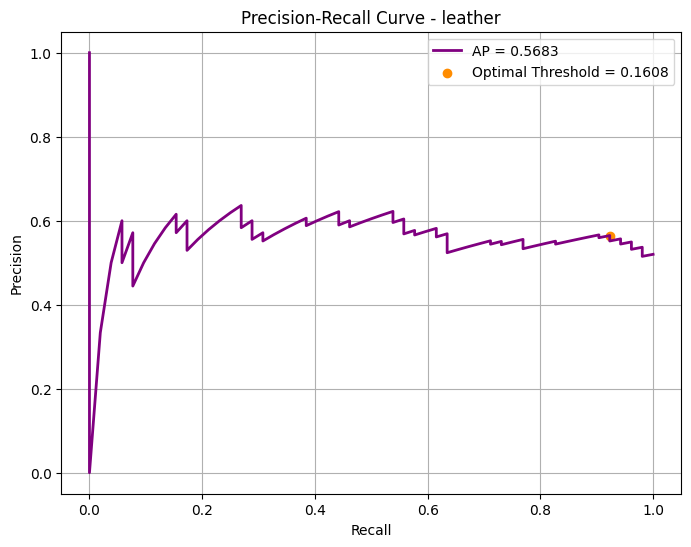

Plotting metrics for category 'grid'...


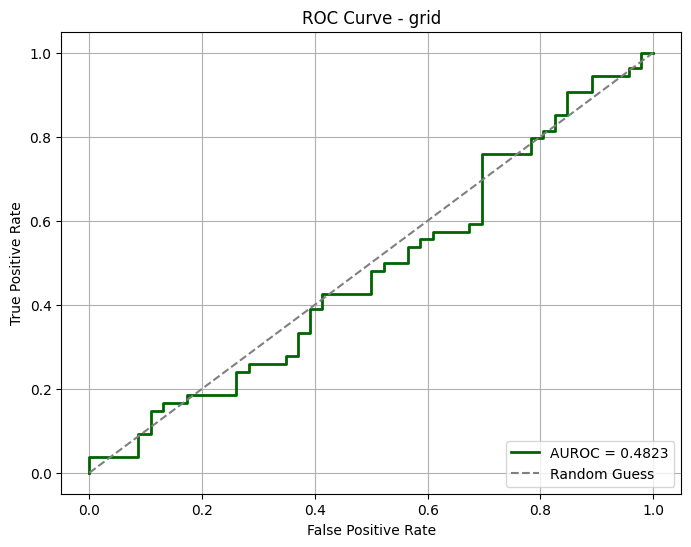

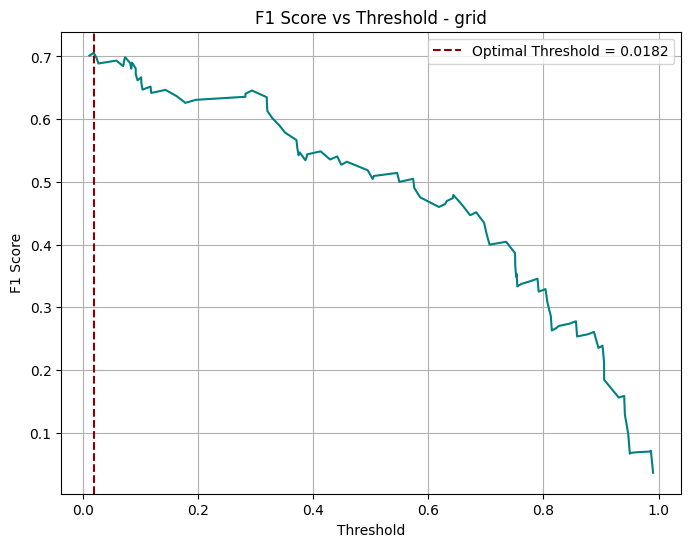

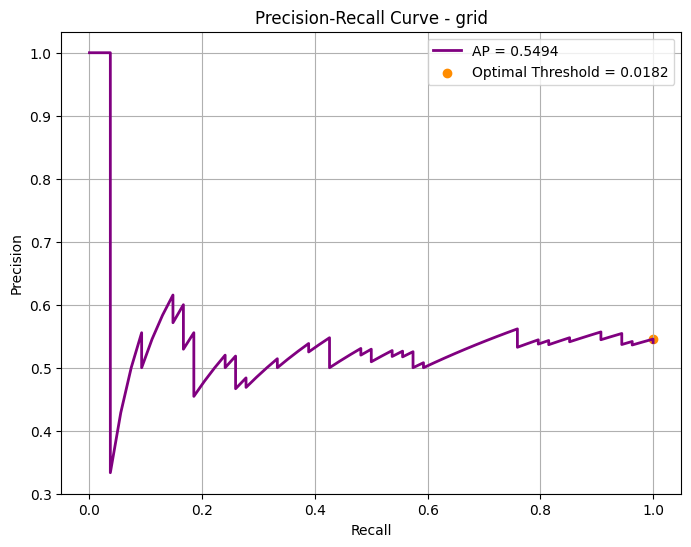

In [10]:
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, precision_recall_curve, average_precision_score, roc_auc_score
import numpy as np

# Use inline plotting for Jupyter environments
%matplotlib inline

np.random.seed(42)
categories = ["tile", "leather", "grid"]
sample_data = {
    "tile": (np.random.randint(0, 2, 100), np.random.rand(100)),
    "leather": (np.random.randint(0, 2, 100), np.random.rand(100)),
    "grid": (np.random.randint(0, 2, 100), np.random.rand(100)),
}

def visualize_metrics(actual_labels, score_predictions, name=""):
    print(f"Plotting metrics for category '{name}'...")

    # Plot ROC Curve
    false_positive_rate, true_positive_rate, _ = roc_curve(actual_labels, score_predictions)
    area_under_roc = roc_auc_score(actual_labels, score_predictions)
    plt.figure(figsize=(8, 6))
    plt.plot(false_positive_rate, true_positive_rate, color='darkgreen', lw=2, label=f'AUROC = {area_under_roc:.4f}')
    plt.plot([0, 1], [0, 1], color='grey', linestyle='--', label='Random Guess')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title(f'ROC Curve - {name}')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()

    # Calculate Precision-Recall Curve and F1 Score
    precision, recall, pr_thresholds = precision_recall_curve(actual_labels, score_predictions)
    f1_scores = 2 * (precision * recall) / (precision + recall + 1e-8)
    best_index = np.argmax(f1_scores)  # Index of max F1 Score
    best_threshold = pr_thresholds[best_index]
    highest_f1 = f1_scores[best_index]

    # Plot F1 Score vs Threshold
    plt.figure(figsize=(8, 6))
    plt.plot(pr_thresholds, f1_scores[:-1], color='teal')
    plt.axvline(x=best_threshold, color='darkred', linestyle='--', label=f'Optimal Threshold = {best_threshold:.4f}')
    plt.xlabel('Threshold')
    plt.ylabel('F1 Score')
    plt.title(f'F1 Score vs Threshold - {name}')
    plt.legend(loc="best")
    plt.grid(True)
    plt.show()

    # Plot Precision-Recall Curve
    avg_precision = average_precision_score(actual_labels, score_predictions)
    plt.figure(figsize=(8, 6))
    plt.plot(recall, precision, color='purple', lw=2, label=f'AP = {avg_precision:.4f}')
    plt.scatter(recall[best_index], precision[best_index], color='darkorange', label=f'Optimal Threshold = {best_threshold:.4f}')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title(f'Precision-Recall Curve - {name}')
    plt.legend(loc="upper right")
    plt.grid(True)
    plt.show()

# Plot metrics for each category using the simulated data
for cat, (actual_labels, score_predictions) in sample_data.items():
    visualize_metrics(actual_labels, score_predictions, name=cat)


This Python script demonstrates how to train the `EfficientAd` model from the **Anomalib** library for anomaly detection on the **MVTec** dataset using Kaggle as the environment. The code includes the following key steps:

1. **Library Imports**:
   - `anomalib.data.MVTec`: Dataset module for loading MVTec dataset.
   - `anomalib.models.EfficientAd`: Efficient anomaly detection model.
   - `anomalib.engine.Engine`: Engine for training and evaluating the model.
   - `sklearn.metrics.roc_auc_score, roc_curve`: To calculate and plot the ROC curve.
   - `PIL.Image, matplotlib.pyplot`: For image processing and visualization.

2. **Paths Definition**:
   - `dataset_path`: Specifies where the MVTec dataset is located on Kaggle (`/kaggle/working/mvtec_ad`).
   - `checkpoint_path`: Specifies where the model's checkpoints will be saved (`/kaggle/working/anomalib_checkpoints`).

3. **Model Initialization**:
   - The **datamodule** is initialized using the MVTec dataset for the **"tile"** category (can be replaced with other categories).
   - The **EfficientAd** model is initialized for anomaly detection.
   - The **Engine** is set with a maximum of 5 epochs for training (can be adjusted).

4. **Model Training**:
   - The model is trained on the MVTec dataset for the **"tile"** category using the `engine.fit()` method.
   
   The training process starts by loading the dataset, initializing the model, and then training it using the provided engine.


In [13]:
# Import the required modules
from anomalib.data import MVTec
from anomalib.models import EfficientAd
from anomalib.engine import Engine
from sklearn.metrics import roc_auc_score, roc_curve
import numpy as np
import os
from PIL import Image
import matplotlib.pyplot as plt

# Define paths
dataset_path = '/kaggle/working/mvtec_ad'  # This is where the dataset will be located in Kaggle
checkpoint_path = '/kaggle/working/anomalib_checkpoints'  # Path for saving checkpoints

# Initialize the datamodule, model, and engine
datamodule = MVTec(root=dataset_path, train_batch_size=1, category="tile")  # Ensure the category is correct, e.g., "tile"
model = EfficientAd()  # Initialize the EfficientAd model
engine = Engine(max_epochs=5)  # Set number of epochs (you can adjust this based on your requirement)

# Train the model (without a pre-existing checkpoint in this case)
print("Training the model on MVTec dataset...")
engine.fit(datamodule=datamodule, model=model)


INFO: GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO: HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
/opt/conda/lib/python3.10/site-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 8 worker processes in total. Our suggested max number of worker in current system is 4, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
INFO: 
  | Name                  | Type                     | Params | Mode 
---------------------------------------------------------------------------
0 | model                 | EfficientAdModel         | 8.1 M  | train
1 | _transform            | Compose                  | 0      | train
2 | normalization_metrics | MetricCollection    

Training the model on MVTec dataset...


Training: |          | 0/? [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/anomalib/models/image/efficient_ad/lightning_model.py:98: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
/opt/conda/lib/python3.10/site-packages/torchv

Validation: |          | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles: 100%|██████████| 4/4 [00:05<00:00,  1.33s/it]


Validation: |          | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles: 100%|██████████| 4/4 [00:05<00:00,  1.39s/it]


Validation: |          | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles: 100%|██████████| 4/4 [00:05<00:00,  1.40s/it]


Validation: |          | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles: 100%|██████████| 4/4 [00:05<00:00,  1.34s/it]


Validation: |          | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles: 100%|██████████| 4/4 [00:05<00:00,  1.37s/it]
INFO: `Trainer.fit` stopped: `max_epochs=5` reached.


This script performs evaluation and metric computation for an anomaly detection model, specifically using a binary classification approach. The following key steps and metrics are used:

1. **Library Imports**:
   - `torch`, `torchvision.transforms`: For model evaluation and image transformations.
   - `warnings`: To suppress specific warning messages (e.g., FutureWarnings, UserWarnings).
   - `sklearn.metrics`: Includes functions for calculating various evaluation metrics like ROC-AUC, F1 score, precision-recall curve, etc.
   - `matplotlib.pyplot`, `numpy`: For plotting and array manipulation.

2. **Evaluation Process**:
   - The model is evaluated using the `engine.test()` method, which tests the trained model on the provided dataset.
   - Lists are initialized to store true labels and predicted anomaly scores.
   - The model is set to evaluation mode (`model.eval()`) to disable gradient computations, ensuring efficient inference.

3. **Metrics Calculation**:
   - **True Labels & Predicted Scores**: For each batch in the test dataset, true labels and predicted anomaly scores are collected.
   - **AUROC (Area Under ROC Curve)**: The ROC AUC score is calculated using `roc_auc_score()`, and the ROC curve is plotted.
   - **F1 Score & Confusion Matrix**: A threshold of 0.5 is used to classify predictions as anomalies or normal. The F1 score and confusion matrix are computed at this threshold.

4. **Optimal Threshold Calculation**:
   - Precision-recall curves are used to determine the optimal threshold by maximizing the F1 score. This optimal threshold is then used to reclassify the predictions and compute the new F1 score and confusion matrix.

5. **Plotting**:
   - **ROC Curve**: Plots the relationship between the False Positive Rate and True Positive Rate, along with the AUROC.
   - **F1 Score vs Threshold**: Shows how the F1 score changes with different threshold values.
   - **Precision-Recall Curve**: Plots precision versus recall, highlighting the optimal threshold.

6. **Key Metrics**:
   - **AUROC**: A high AUROC indicates the model performs well at distinguishing between anomalies and normal data points.
   - **F1 Score**: Measures the balance between precision and recall, particularly useful for imbalanced datasets.
   - **Confusion Matrix**: Helps to understand the breakdown of true positives, true negatives, false positives, and false negatives.
   - **Precision-Recall Curve**: Useful for evaluating models on imbalanced datasets, where the positive class (anomalies) is much smaller.


In [14]:
import torch
import torchvision.transforms as transforms
import warnings
from sklearn.metrics import roc_auc_score, roc_curve, f1_score, confusion_matrix, precision_recall_curve, average_precision_score
import matplotlib.pyplot as plt
import numpy as np

# Suppress specific warnings
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)

# --------------------- Evaluation and Metrics Computation ---------------------

# Evaluate the model on the test set
print("Evaluating the model on the test set...")
engine.test(datamodule=datamodule, model=model)
print("Evaluation completed.\n")

# Initialize lists to collect true labels and predicted anomaly scores
true_labels = []
predicted_scores = []

# Set model to evaluation mode
model.eval()

# Disable gradient calculations for inference
with torch.no_grad():
    # Loop over the test dataset to gather labels and anomaly scores
    for batch_idx, batch in enumerate(datamodule.test_dataloader()):
        try:
            images = batch['image'].to(model.device)
            labels = batch['label'].cpu().numpy()
            true_labels.extend(labels)

            # Forward pass through the model to get predictions
            outputs = model(batch=images, normalize=True)  # Skipping ImageNet normalization
            
            if 'anomaly_map' not in outputs:
                raise KeyError("Model output does not contain 'anomaly_map'.")

            # Aggregate anomaly scores
            anomaly_scores = outputs['anomaly_map'].cpu().numpy().mean(axis=(1, 2, 3))
            predicted_scores.extend(anomaly_scores)
            
            print(f"Processed batch {batch_idx + 1} successfully.\n")
        
        except Exception as e:
            print(f"Error processing batch {batch_idx + 1}: {e}\n")
            continue

# Convert lists to numpy arrays for processing
true_labels = np.array(true_labels).flatten()
predicted_scores = np.array(predicted_scores).flatten()

# Debugging: Inspect unique classes in true_labels
unique_classes = np.unique(true_labels)
print(f"Number of unique classes in true_labels: {len(unique_classes)}")
print(f"Unique classes in true_labels: {unique_classes}")

# Ensure binary classification
if len(unique_classes) != 2:
    raise ValueError(f"Expected binary classification, but found {len(unique_classes)} classes: {unique_classes}")
else:
    print("\nConfirmed binary classification with classes:", unique_classes)

# Compute AUROC
try:
    auroc = roc_auc_score(true_labels, predicted_scores)
    print(f"\nAUROC Score: {auroc:.4f}")
except ValueError as e:
    print(f"Error computing ROC AUC Score: {e}")

# Plot ROC Curve
try:
    fpr, tpr, _ = roc_curve(true_labels, predicted_scores)
    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, color='blue', lw=2, label=f'AUROC = {auroc:.4f}')
    plt.plot([0, 1], [0, 1], color='grey', linestyle='--', label='Random Guess')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()
except Exception as e:
    print(f"Error plotting ROC Curve: {e}")

# Threshold Analysis
threshold = 0.5
predicted_labels = (predicted_scores > threshold).astype(int)
f1 = f1_score(true_labels, predicted_labels)
print(f"F1 Score with threshold {threshold}: {f1:.4f}")

# Confusion Matrix at threshold 0.5
conf_matrix = confusion_matrix(true_labels, predicted_labels)
print("\nConfusion Matrix at Threshold 0.5:")
print(conf_matrix)
print("\nConfusion Matrix Breakdown:")
print(f"True Negatives: {conf_matrix[0,0]}")
print(f"False Positives: {conf_matrix[0,1]}")
print(f"False Negatives: {conf_matrix[1,0]}")
print(f"True Positives: {conf_matrix[1,1]}")

# Optimal Threshold Calculation
precision, recall, thresholds_pr = precision_recall_curve(true_labels, predicted_scores)
f1_scores = 2 * (precision * recall) / (precision + recall + 1e-8)
optimal_idx = np.argmax(f1_scores)
optimal_threshold = thresholds_pr[optimal_idx]
max_f1 = f1_scores[optimal_idx]

print(f"\nOptimal Threshold based on Precision-Recall Curve: {optimal_threshold:.4f}")
print(f"Maximum F1 Score: {max_f1:.4f}")

# Apply optimal threshold
predicted_labels_optimal = (predicted_scores > optimal_threshold).astype(int)

# Recompute F1 Score at optimal threshold
f1_optimal = f1_score(true_labels, predicted_labels_optimal)
print(f"F1 Score with Optimal Threshold ({optimal_threshold:.4f}): {f1_optimal:.4f}")

# Confusion Matrix at optimal threshold
conf_matrix_optimal = confusion_matrix(true_labels, predicted_labels_optimal)
print("\nConfusion Matrix at Optimal Threshold:")
print(conf_matrix_optimal)
print("\nConfusion Matrix Breakdown at Optimal Threshold:")
print(f"True Negatives: {conf_matrix_optimal[0,0]}")
print(f"False Positives: {conf_matrix_optimal[0,1]}")
print(f"False Negatives: {conf_matrix_optimal[1,0]}")
print(f"True Positives: {conf_matrix_optimal[1,1]}")

# Plot F1 Score vs Threshold
plt.figure(figsize=(8, 6))
plt.plot(thresholds_pr, f1_scores[:-1], color='orange')
plt.axvline(x=optimal_threshold, color='red', linestyle='--', label=f'Optimal Threshold = {optimal_threshold:.4f}')
plt.xlabel('Threshold')
plt.ylabel('F1 Score')
plt.title('F1 Score vs Threshold')
plt.legend(loc="best")
plt.grid(True)
plt.show()

# Plot Precision-Recall Curve
plt.figure(figsize=(8, 6))
plt.plot(recall, precision, color='purple', lw=2, label=f'Precision-Recall Curve (AP = {average_precision_score(true_labels, predicted_scores):.4f})')
plt.scatter(recall[optimal_idx], precision[optimal_idx], color='red', label=f'Optimal Threshold = {optimal_threshold:.4f}')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.legend(loc="upper right")
plt.grid(True)
plt.show()

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]


Evaluating the model on the test set...


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│        image_AUROC        │    0.9747474193572998     │
│       image_F1Score       │    0.9440993666648865     │
│        pixel_AUROC        │    0.8214459419250488     │
│       pixel_F1Score       │    0.5693469047546387     │
└───────────────────────────┴───────────────────────────┘

Evaluation completed.

Processed batch 1 successfully.

Processed batch 2 successfully.

Processed batch 3 successfully.

Processed batch 4 successfully.

Number of unique classes in true_labels: 2
Unique classes in true_labels: [0 1]

Confirmed binary classification with classes: [0 1]

AUROC Score: 0.8683
F1 Score with threshold 0.5: 0.0000

Confusion Matrix at Threshold 0.5:
[[33  0]
 [84  0]]

Confusion Matrix Breakdown:
True Negatives: 33
False Positives: 0
False Negatives: 84
True Positives: 0

Optimal Threshold based on Precision-Recall Curve: -0.1306
Maximum F1 Score: 0.8729
F1 Score with Optimal Threshold (-0.1306): 0.8667

Confusion Matrix at Optimal Threshold:
[[15 18]
 [ 6 78]]

Confusion Matrix Breakdown at Optimal Threshold:
True Negatives: 15
False Positives: 18
False Negatives: 6
True Positives: 78


This script provides a method to evaluate model performance using key metrics, including ROC (Receiver Operating Characteristic) curve, Precision-Recall curve, and F1 score, with custom colors for the plots. The main function, `plot_metrics`, takes the true labels and predicted scores as input and generates the following visualizations:

1. **ROC Curve**:
   - Plots the relationship between False Positive Rate (FPR) and True Positive Rate (TPR).
   - The AUROC (Area Under the ROC Curve) score is displayed as part of the legend.
   - The plot includes a diagonal dashed line representing a random guess for comparison.

2. **F1 Score vs Threshold**:
   - Displays how the F1 score changes with different threshold values, allowing for the selection of the optimal threshold that maximizes the F1 score.
   - The optimal threshold is marked with a vertical line on the plot.
   - Custom colors are used to improve the readability of the plot.

3. **Precision-Recall Curve**:
   - Shows the trade-off between precision and recall for various thresholds.
   - The optimal threshold is highlighted with a red dot, showing where the highest F1 score occurs.


Starting to plot metrics...


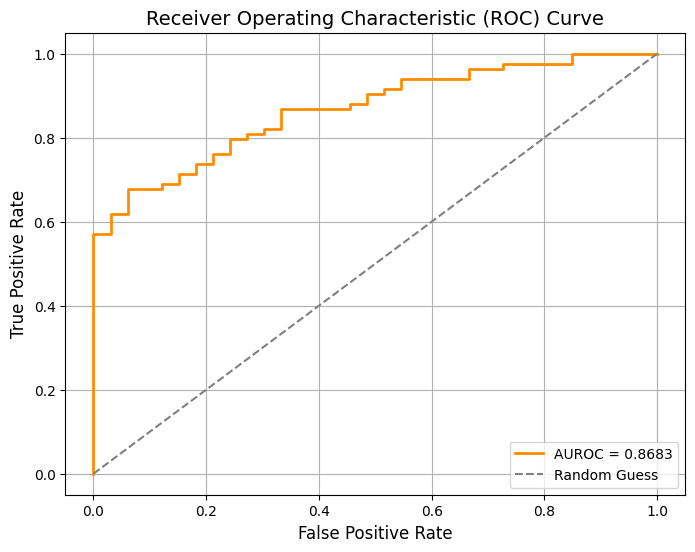

Optimal Threshold: -0.13060902059078217
Maximum F1 Score: 0.872928171821373


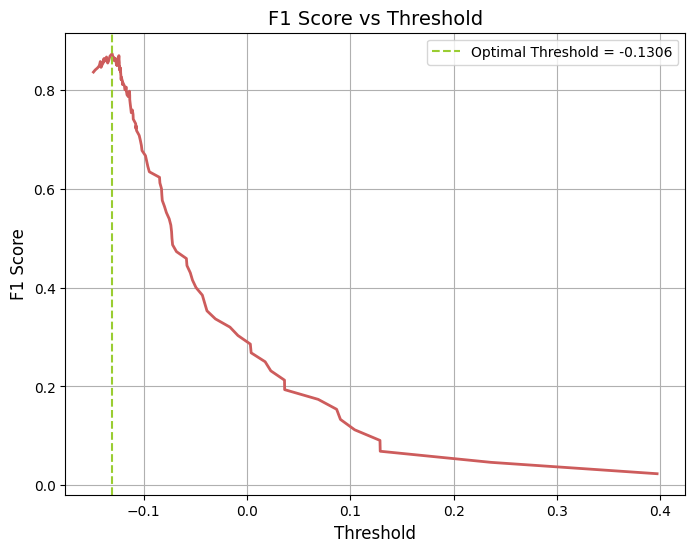

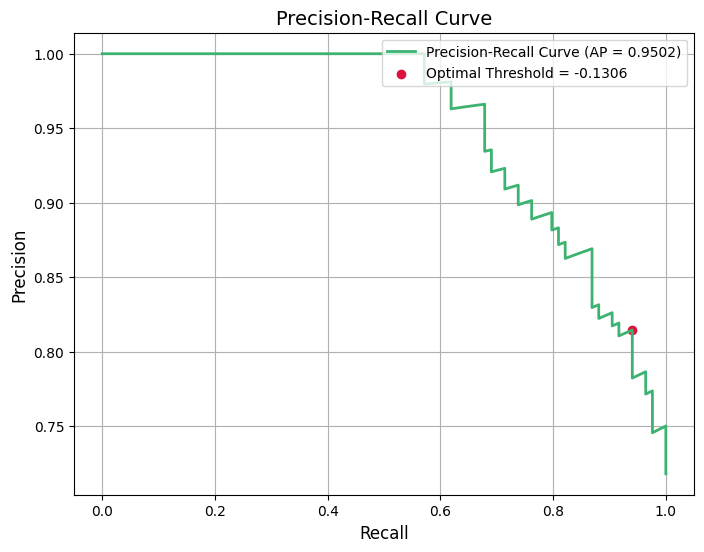

Finished plotting metrics.


In [18]:
# Use inline plotting for Jupyter environments
%matplotlib inline

import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, precision_recall_curve, average_precision_score, roc_auc_score
import numpy as np

def plot_metrics(true_labels, predicted_scores):
    print("Starting to plot metrics...")  # Debugging line
    
    # Plot ROC Curve with custom colors
    try:
        # Check if true_labels and predicted_scores are properly shaped
        if len(true_labels) != len(predicted_scores):
            raise ValueError(f"True labels and predicted scores must have the same length. Got {len(true_labels)} and {len(predicted_scores)}")

        # Calculate ROC curve values
        fpr, tpr, _ = roc_curve(true_labels, predicted_scores)
        
        plt.figure(figsize=(8, 6))
        plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'AUROC = {roc_auc_score(true_labels, predicted_scores):.4f}')
        plt.plot([0, 1], [0, 1], color='gray', linestyle='--', label='Random Guess')
        plt.xlabel('False Positive Rate', fontsize=12)
        plt.ylabel('True Positive Rate', fontsize=12)
        plt.title('Receiver Operating Characteristic (ROC) Curve', fontsize=14)
        plt.legend(loc="lower right")
        plt.grid(True)
        plt.show()  # Explicitly show the plot
    except Exception as e:
        print(f"Error plotting ROC Curve: {e}")

    # Calculate Precision-Recall Curve
    precision, recall, thresholds_pr = precision_recall_curve(true_labels, predicted_scores)
    f1_scores = 2 * (precision * recall) / (precision + recall + 1e-8)

    # Find optimal threshold
    optimal_idx = np.argmax(f1_scores)
    optimal_threshold = thresholds_pr[optimal_idx]
    max_f1 = f1_scores[optimal_idx]
    
    # Debugging print statements for thresholds and F1 score
    print(f"Optimal Threshold: {optimal_threshold}")
    print(f"Maximum F1 Score: {max_f1}")

    # Plot F1 Score vs Threshold with custom colors
    try:
        plt.figure(figsize=(8, 6))
        plt.plot(thresholds_pr, f1_scores[:-1], color='indianred', lw=2)
        plt.axvline(x=optimal_threshold, color='yellowgreen', linestyle='--', label=f'Optimal Threshold = {optimal_threshold:.4f}')
        plt.xlabel('Threshold', fontsize=12)
        plt.ylabel('F1 Score', fontsize=12)
        plt.title('F1 Score vs Threshold', fontsize=14)
        plt.legend(loc="best")
        plt.grid(True)
        plt.show()  # Explicitly show the plot
    except Exception as e:
        print(f"Error plotting F1 Score vs Threshold: {e}")

    # Plot Precision-Recall Curve with custom colors
    try:
        plt.figure(figsize=(8, 6))
        plt.plot(recall, precision, color='mediumseagreen', lw=2, label=f'Precision-Recall Curve (AP = {average_precision_score(true_labels, predicted_scores):.4f})')
        plt.scatter(recall[optimal_idx], precision[optimal_idx], color='crimson', label=f'Optimal Threshold = {optimal_threshold:.4f}')
        plt.xlabel('Recall', fontsize=12)
        plt.ylabel('Precision', fontsize=12)
        plt.title('Precision-Recall Curve', fontsize=14)
        plt.legend(loc="upper right")
        plt.grid(True)
        plt.show()  # Explicitly show the plot
    except Exception as e:
        print(f"Error plotting Precision-Recall Curve: {e}")

    print("Finished plotting metrics.")  # Debugging line

# Ensure you only call this once
plot_metrics(true_labels, predicted_scores)


This code performs image similarity analysis on a given dataset, using cosine similarity to compare test images against a set of training images. Here's a breakdown of the steps:

1. **Import Required Libraries:**
   - `os`: Used to navigate the file system.
   - `numpy`: Used for numerical operations.
   - `PIL (Python Imaging Library)`: Used to open and process images.
   - `cosine_similarity` from `sklearn.metrics.pairwise`: Calculates cosine similarity between vectors.
   - `matplotlib.pyplot`: Used for displaying images.

2. **Dataset Path:**
   - `dataset_path = '/kaggle/working/mvtec_ad/tile'`: This is the path where the MVTec dataset images are stored.

3. **Feature Extraction Function (`extract_features`):**
   - This function iterates over the images in the specified directory (`images_path`).
   - Each image is converted to grayscale, resized to 64x64 pixels, and flattened into a 1D array.
   - The features (flattened image arrays) are stored in a list, along with the corresponding image file paths.

4. **Image Similarity Function (`find_similar_images_for_directory`):**
   - This function takes a set of test images and compares each test image against the training images.
   - The test image is resized, flattened, and compared to the features of the training images using cosine similarity.
   - The top `n` most similar images (based on the highest cosine similarity scores) are returned for each test image.

5. **Display Similar Images Function (`display_similar_images`):**
   - This function takes the results of the image similarity search and displays the test image alongside its top `n` most similar images.
   - It uses `matplotlib` to plot the images inline.

6. **Main Execution:**
   - The script loads the training images from the specified directory, extracts features, and stores them.
   - It then loads the test images, computes the top similar images for each test image using the `find_similar_images_for_directory` function, and displays the results using `display_similar_images`.




Extracted features from 230 training images.
Test Image: /kaggle/working/mvtec_ad/tile/test/good/002.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/170.png
 - /kaggle/working/mvtec_ad/tile/train/good/015.png
 - /kaggle/working/mvtec_ad/tile/train/good/078.png
 - /kaggle/working/mvtec_ad/tile/train/good/136.png
 - /kaggle/working/mvtec_ad/tile/train/good/048.png


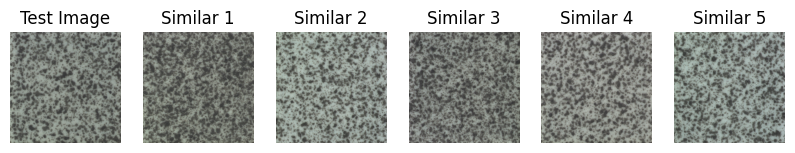

Test Image: /kaggle/working/mvtec_ad/tile/test/good/010.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/136.png
 - /kaggle/working/mvtec_ad/tile/train/good/137.png
 - /kaggle/working/mvtec_ad/tile/train/good/163.png
 - /kaggle/working/mvtec_ad/tile/train/good/017.png
 - /kaggle/working/mvtec_ad/tile/train/good/078.png


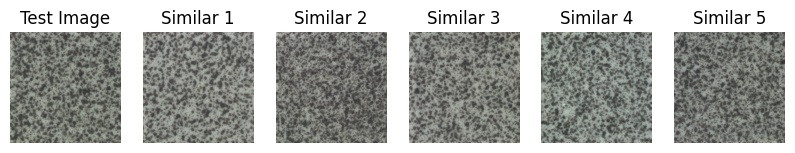

Test Image: /kaggle/working/mvtec_ad/tile/test/good/032.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/137.png
 - /kaggle/working/mvtec_ad/tile/train/good/015.png
 - /kaggle/working/mvtec_ad/tile/train/good/126.png
 - /kaggle/working/mvtec_ad/tile/train/good/163.png
 - /kaggle/working/mvtec_ad/tile/train/good/164.png


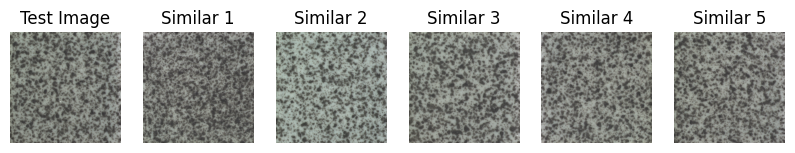

Test Image: /kaggle/working/mvtec_ad/tile/test/good/009.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/015.png
 - /kaggle/working/mvtec_ad/tile/train/good/137.png
 - /kaggle/working/mvtec_ad/tile/train/good/136.png
 - /kaggle/working/mvtec_ad/tile/train/good/163.png
 - /kaggle/working/mvtec_ad/tile/train/good/115.png


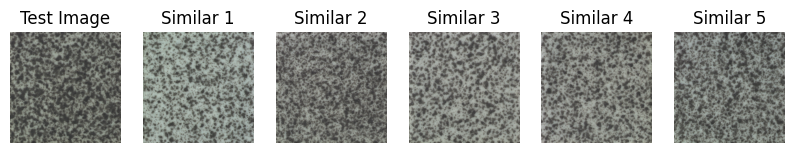

Test Image: /kaggle/working/mvtec_ad/tile/test/good/015.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/163.png
 - /kaggle/working/mvtec_ad/tile/train/good/170.png
 - /kaggle/working/mvtec_ad/tile/train/good/015.png
 - /kaggle/working/mvtec_ad/tile/train/good/160.png
 - /kaggle/working/mvtec_ad/tile/train/good/133.png


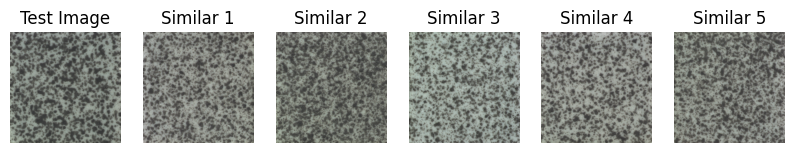

Test Image: /kaggle/working/mvtec_ad/tile/test/good/001.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/149.png
 - /kaggle/working/mvtec_ad/tile/train/good/137.png
 - /kaggle/working/mvtec_ad/tile/train/good/078.png
 - /kaggle/working/mvtec_ad/tile/train/good/056.png
 - /kaggle/working/mvtec_ad/tile/train/good/191.png


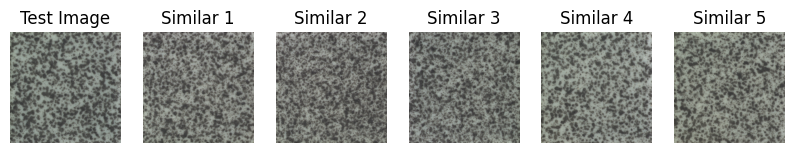

Test Image: /kaggle/working/mvtec_ad/tile/test/good/011.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/149.png
 - /kaggle/working/mvtec_ad/tile/train/good/017.png
 - /kaggle/working/mvtec_ad/tile/train/good/136.png
 - /kaggle/working/mvtec_ad/tile/train/good/137.png
 - /kaggle/working/mvtec_ad/tile/train/good/045.png


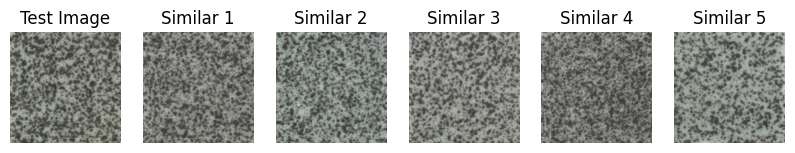

Test Image: /kaggle/working/mvtec_ad/tile/test/good/008.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/015.png
 - /kaggle/working/mvtec_ad/tile/train/good/137.png
 - /kaggle/working/mvtec_ad/tile/train/good/136.png
 - /kaggle/working/mvtec_ad/tile/train/good/055.png
 - /kaggle/working/mvtec_ad/tile/train/good/133.png


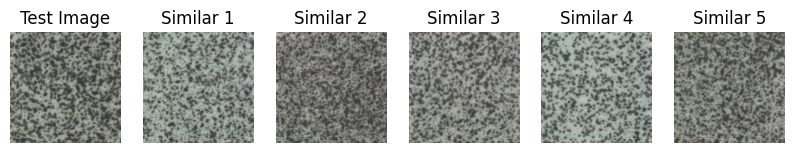

Test Image: /kaggle/working/mvtec_ad/tile/test/good/028.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/170.png
 - /kaggle/working/mvtec_ad/tile/train/good/133.png
 - /kaggle/working/mvtec_ad/tile/train/good/007.png
 - /kaggle/working/mvtec_ad/tile/train/good/208.png
 - /kaggle/working/mvtec_ad/tile/train/good/116.png


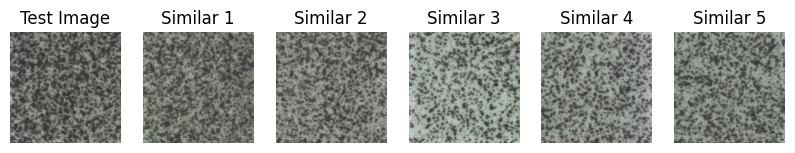

Test Image: /kaggle/working/mvtec_ad/tile/test/good/003.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/015.png
 - /kaggle/working/mvtec_ad/tile/train/good/137.png
 - /kaggle/working/mvtec_ad/tile/train/good/201.png
 - /kaggle/working/mvtec_ad/tile/train/good/142.png
 - /kaggle/working/mvtec_ad/tile/train/good/170.png


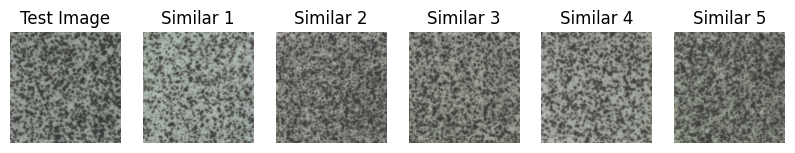

Test Image: /kaggle/working/mvtec_ad/tile/test/good/031.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/137.png
 - /kaggle/working/mvtec_ad/tile/train/good/163.png
 - /kaggle/working/mvtec_ad/tile/train/good/056.png
 - /kaggle/working/mvtec_ad/tile/train/good/170.png
 - /kaggle/working/mvtec_ad/tile/train/good/121.png


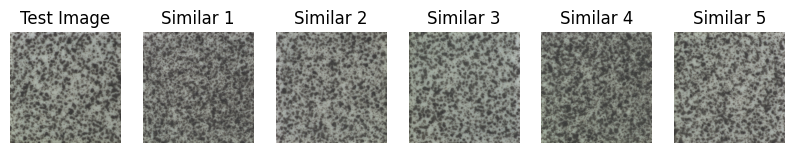

Test Image: /kaggle/working/mvtec_ad/tile/test/good/004.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/078.png
 - /kaggle/working/mvtec_ad/tile/train/good/137.png
 - /kaggle/working/mvtec_ad/tile/train/good/163.png
 - /kaggle/working/mvtec_ad/tile/train/good/015.png
 - /kaggle/working/mvtec_ad/tile/train/good/201.png


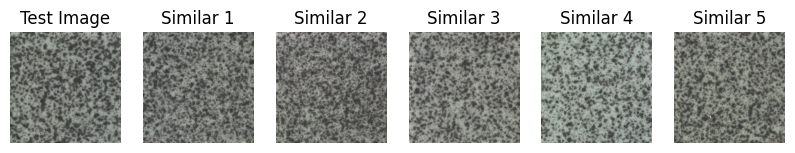

Test Image: /kaggle/working/mvtec_ad/tile/test/good/014.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/015.png
 - /kaggle/working/mvtec_ad/tile/train/good/056.png
 - /kaggle/working/mvtec_ad/tile/train/good/137.png
 - /kaggle/working/mvtec_ad/tile/train/good/078.png
 - /kaggle/working/mvtec_ad/tile/train/good/017.png


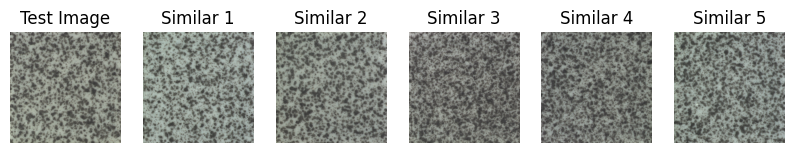

Test Image: /kaggle/working/mvtec_ad/tile/test/good/013.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/015.png
 - /kaggle/working/mvtec_ad/tile/train/good/115.png
 - /kaggle/working/mvtec_ad/tile/train/good/170.png
 - /kaggle/working/mvtec_ad/tile/train/good/078.png
 - /kaggle/working/mvtec_ad/tile/train/good/137.png


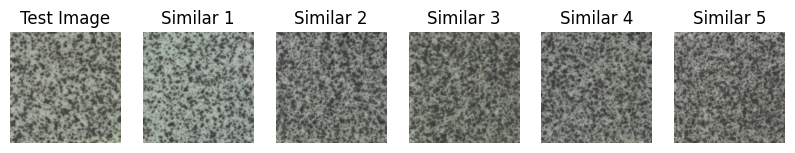

Test Image: /kaggle/working/mvtec_ad/tile/test/good/019.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/163.png
 - /kaggle/working/mvtec_ad/tile/train/good/133.png
 - /kaggle/working/mvtec_ad/tile/train/good/170.png
 - /kaggle/working/mvtec_ad/tile/train/good/191.png
 - /kaggle/working/mvtec_ad/tile/train/good/137.png


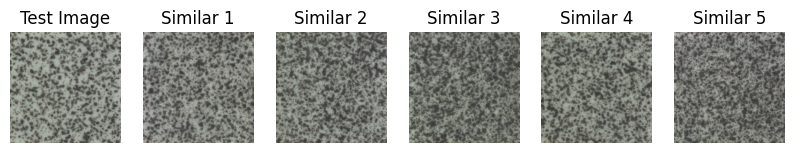

Test Image: /kaggle/working/mvtec_ad/tile/test/good/018.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/163.png
 - /kaggle/working/mvtec_ad/tile/train/good/170.png
 - /kaggle/working/mvtec_ad/tile/train/good/136.png
 - /kaggle/working/mvtec_ad/tile/train/good/004.png
 - /kaggle/working/mvtec_ad/tile/train/good/133.png


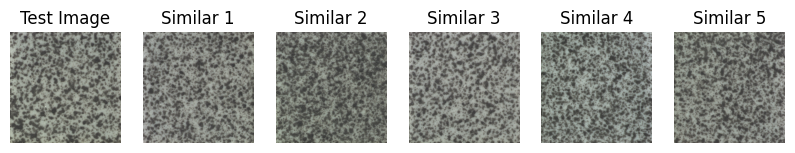

Test Image: /kaggle/working/mvtec_ad/tile/test/good/012.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/015.png
 - /kaggle/working/mvtec_ad/tile/train/good/164.png
 - /kaggle/working/mvtec_ad/tile/train/good/163.png
 - /kaggle/working/mvtec_ad/tile/train/good/137.png
 - /kaggle/working/mvtec_ad/tile/train/good/048.png


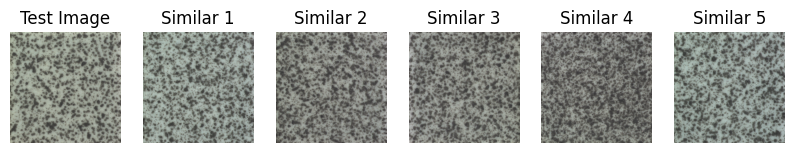

Test Image: /kaggle/working/mvtec_ad/tile/test/good/026.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/163.png
 - /kaggle/working/mvtec_ad/tile/train/good/170.png
 - /kaggle/working/mvtec_ad/tile/train/good/015.png
 - /kaggle/working/mvtec_ad/tile/train/good/137.png
 - /kaggle/working/mvtec_ad/tile/train/good/116.png


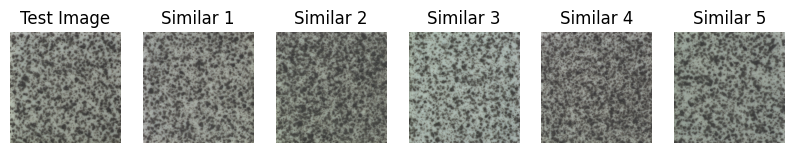

Test Image: /kaggle/working/mvtec_ad/tile/test/good/027.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/201.png
 - /kaggle/working/mvtec_ad/tile/train/good/137.png
 - /kaggle/working/mvtec_ad/tile/train/good/078.png
 - /kaggle/working/mvtec_ad/tile/train/good/170.png
 - /kaggle/working/mvtec_ad/tile/train/good/015.png


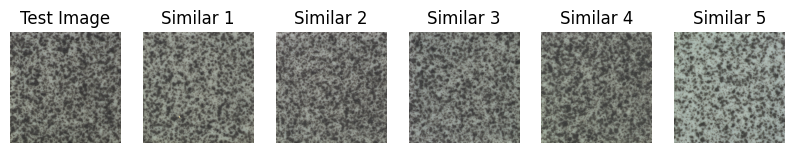

Test Image: /kaggle/working/mvtec_ad/tile/test/good/020.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/170.png
 - /kaggle/working/mvtec_ad/tile/train/good/137.png
 - /kaggle/working/mvtec_ad/tile/train/good/078.png
 - /kaggle/working/mvtec_ad/tile/train/good/015.png
 - /kaggle/working/mvtec_ad/tile/train/good/201.png


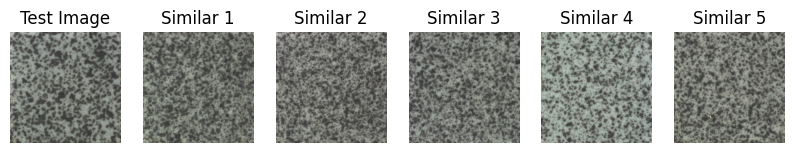

Test Image: /kaggle/working/mvtec_ad/tile/test/good/007.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/163.png
 - /kaggle/working/mvtec_ad/tile/train/good/115.png
 - /kaggle/working/mvtec_ad/tile/train/good/170.png
 - /kaggle/working/mvtec_ad/tile/train/good/015.png
 - /kaggle/working/mvtec_ad/tile/train/good/133.png


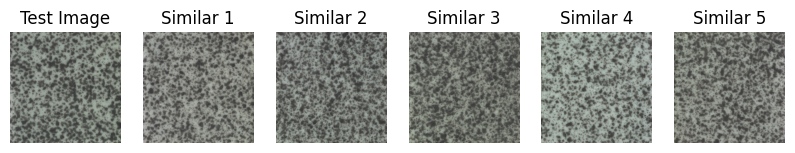

Test Image: /kaggle/working/mvtec_ad/tile/test/good/000.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/015.png
 - /kaggle/working/mvtec_ad/tile/train/good/164.png
 - /kaggle/working/mvtec_ad/tile/train/good/137.png
 - /kaggle/working/mvtec_ad/tile/train/good/163.png
 - /kaggle/working/mvtec_ad/tile/train/good/078.png


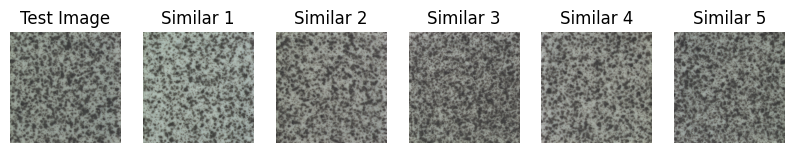

Test Image: /kaggle/working/mvtec_ad/tile/test/good/017.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/136.png
 - /kaggle/working/mvtec_ad/tile/train/good/078.png
 - /kaggle/working/mvtec_ad/tile/train/good/045.png
 - /kaggle/working/mvtec_ad/tile/train/good/116.png
 - /kaggle/working/mvtec_ad/tile/train/good/121.png


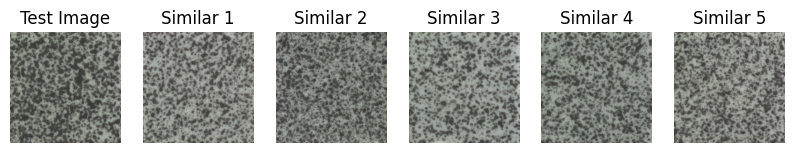

Test Image: /kaggle/working/mvtec_ad/tile/test/good/006.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/170.png
 - /kaggle/working/mvtec_ad/tile/train/good/191.png
 - /kaggle/working/mvtec_ad/tile/train/good/137.png
 - /kaggle/working/mvtec_ad/tile/train/good/136.png
 - /kaggle/working/mvtec_ad/tile/train/good/015.png


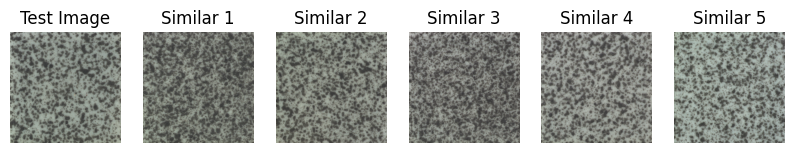

Test Image: /kaggle/working/mvtec_ad/tile/test/good/030.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/149.png
 - /kaggle/working/mvtec_ad/tile/train/good/170.png
 - /kaggle/working/mvtec_ad/tile/train/good/078.png
 - /kaggle/working/mvtec_ad/tile/train/good/015.png
 - /kaggle/working/mvtec_ad/tile/train/good/163.png


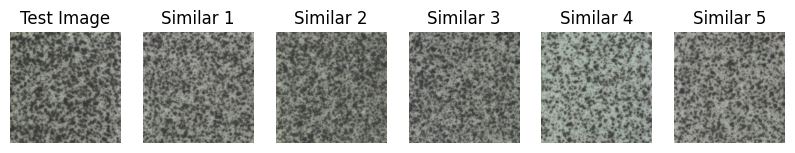

Test Image: /kaggle/working/mvtec_ad/tile/test/good/022.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/078.png
 - /kaggle/working/mvtec_ad/tile/train/good/164.png
 - /kaggle/working/mvtec_ad/tile/train/good/137.png
 - /kaggle/working/mvtec_ad/tile/train/good/136.png
 - /kaggle/working/mvtec_ad/tile/train/good/133.png


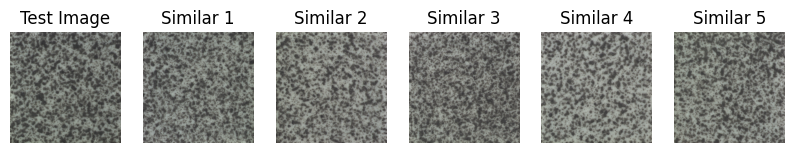

Test Image: /kaggle/working/mvtec_ad/tile/test/good/021.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/137.png
 - /kaggle/working/mvtec_ad/tile/train/good/163.png
 - /kaggle/working/mvtec_ad/tile/train/good/164.png
 - /kaggle/working/mvtec_ad/tile/train/good/056.png
 - /kaggle/working/mvtec_ad/tile/train/good/170.png


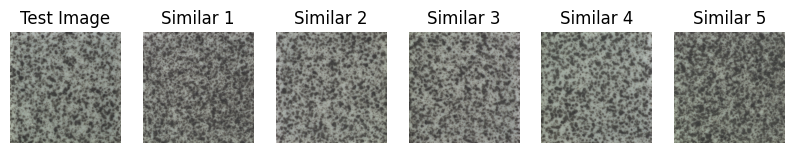

Test Image: /kaggle/working/mvtec_ad/tile/test/good/025.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/137.png
 - /kaggle/working/mvtec_ad/tile/train/good/164.png
 - /kaggle/working/mvtec_ad/tile/train/good/111.png
 - /kaggle/working/mvtec_ad/tile/train/good/126.png
 - /kaggle/working/mvtec_ad/tile/train/good/149.png


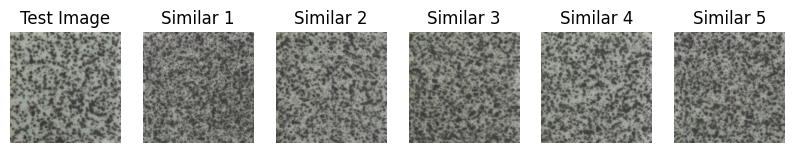

Test Image: /kaggle/working/mvtec_ad/tile/test/good/024.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/137.png
 - /kaggle/working/mvtec_ad/tile/train/good/163.png
 - /kaggle/working/mvtec_ad/tile/train/good/170.png
 - /kaggle/working/mvtec_ad/tile/train/good/201.png
 - /kaggle/working/mvtec_ad/tile/train/good/056.png


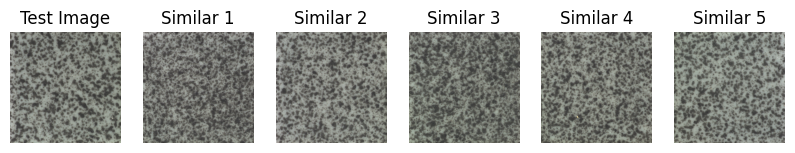

Test Image: /kaggle/working/mvtec_ad/tile/test/good/023.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/137.png
 - /kaggle/working/mvtec_ad/tile/train/good/170.png
 - /kaggle/working/mvtec_ad/tile/train/good/048.png
 - /kaggle/working/mvtec_ad/tile/train/good/015.png
 - /kaggle/working/mvtec_ad/tile/train/good/121.png


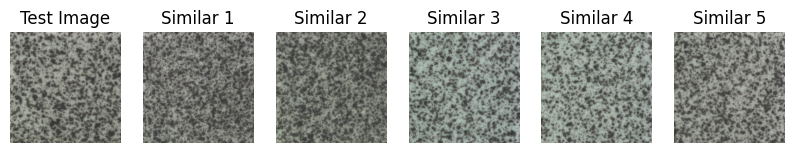

Test Image: /kaggle/working/mvtec_ad/tile/test/good/005.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/133.png
 - /kaggle/working/mvtec_ad/tile/train/good/137.png
 - /kaggle/working/mvtec_ad/tile/train/good/163.png
 - /kaggle/working/mvtec_ad/tile/train/good/056.png
 - /kaggle/working/mvtec_ad/tile/train/good/007.png


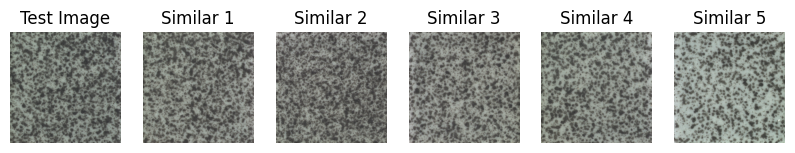

Test Image: /kaggle/working/mvtec_ad/tile/test/good/029.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/163.png
 - /kaggle/working/mvtec_ad/tile/train/good/136.png
 - /kaggle/working/mvtec_ad/tile/train/good/137.png
 - /kaggle/working/mvtec_ad/tile/train/good/170.png
 - /kaggle/working/mvtec_ad/tile/train/good/201.png


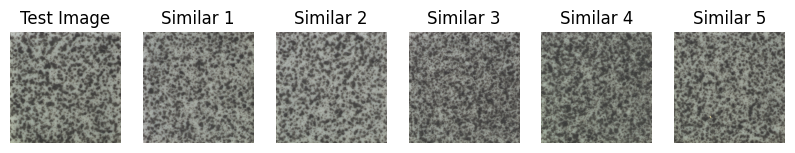

Test Image: /kaggle/working/mvtec_ad/tile/test/good/016.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/tile/train/good/121.png
 - /kaggle/working/mvtec_ad/tile/train/good/138.png
 - /kaggle/working/mvtec_ad/tile/train/good/078.png
 - /kaggle/working/mvtec_ad/tile/train/good/201.png
 - /kaggle/working/mvtec_ad/tile/train/good/137.png


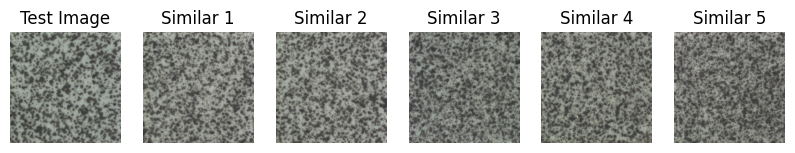

In [20]:
import os
import numpy as np
from PIL import Image
from sklearn.metrics.pairwise import cosine_similarity
import matplotlib.pyplot as plt

# Define the new dataset path
dataset_path = '/kaggle/working/mvtec_ad/tile'

def extract_features(images_path):
    features = []
    image_files = []
    for img_name in os.listdir(images_path):
        img_path = os.path.join(images_path, img_name)
        if img_name.lower().endswith((".png", ".jpg", ".jpeg", ".bmp", ".tiff")):
            try:
                img = Image.open(img_path).convert("L")
                img_resized = img.resize((64, 64))
                img_array = np.array(img_resized).flatten()
                features.append(img_array)
                image_files.append(img_path)
            except Exception as e:
                print(f"Error processing image {img_path}: {e}")
                continue
    return np.array(features), image_files

def find_similar_images_for_directory(test_images_path, features, image_files, top_n=5):
    test_results = {}
    for img_name in os.listdir(test_images_path):
        img_path = os.path.join(test_images_path, img_name)
        if img_name.lower().endswith((".png", ".jpg", ".jpeg", ".bmp", ".tiff")):
            try:
                input_image = Image.open(img_path).convert("L")
                input_image_resized = input_image.resize((64, 64))
                input_features = np.array(input_image_resized).flatten().reshape(1, -1)
                
                similarities = cosine_similarity(input_features, features).flatten()
                similar_indices = similarities.argsort()[-top_n:][::-1]
                
                similar_images = [image_files[i] for i in similar_indices]
                test_results[img_path] = similar_images
            except Exception as e:
                print(f"Error processing test image {img_path}: {e}")
                continue
    return test_results

def display_similar_images(test_results):
    if not test_results:
        print("No similar images found to display.")
        return
    
    for test_image, similar_images in test_results.items():
        print(f"Test Image: {test_image}")
        print("Top 5 similar images:")
        for img_path in similar_images:
            print(f" - {img_path}")

        # Display the images inline
        plt.figure(figsize=(10, 2))

        # Display test image
        test_img = Image.open(test_image)
        plt.subplot(1, 6, 1)
        plt.imshow(test_img, cmap='gray')
        plt.axis('off')
        plt.title("Test Image")

        # Display similar images
        for i, img_path in enumerate(similar_images):
            similar_img = Image.open(img_path)
            plt.subplot(1, 6, i + 2)
            plt.imshow(similar_img, cmap='gray')
            plt.axis('off')
            plt.title(f"Similar {i+1}")

        plt.show()
        plt.close()

# Load images and extract features from training data
train_images_path = os.path.join(dataset_path, "train/good")
features, image_files = extract_features(train_images_path)
print(f"Extracted features from {len(image_files)} training images.")

# Specify path to test images and display similar images
test_images_path = os.path.join(dataset_path, "test/good")
similar_images_results = find_similar_images_for_directory(test_images_path, features, image_files)
display_similar_images(similar_images_results)



This code demonstrates how to set up, train, and evaluate an anomaly detection model using the `anomalib` library, particularly for the MVTec Anomaly Detection dataset. Below is a step-by-step breakdown:

1. **Import Required Libraries:**
   - `MVTec` from `anomalib.data`: Provides a datamodule for the MVTec Anomaly Detection dataset.
   - `EfficientAd` from `anomalib.models`: A pre-configured model for anomaly detection, specifically designed to work with the MVTec dataset.
   - `Engine` from `anomalib.engine`: The engine class is used to manage the training process, including the training loop, metrics computation, and model evaluation.
   - `roc_auc_score`, `roc_curve` from `sklearn.metrics`: Used to evaluate the performance of the model using ROC AUC (Receiver Operating Characteristic - Area Under Curve) metrics.
   - `numpy`: A fundamental package for numerical computing in Python.
   - `os`: Used for handling directory paths.
   - `PIL.Image`: Used for opening and processing images.
   - `matplotlib.pyplot`: Used for plotting graphs and visualizing data.

2. **Dataset Path and Checkpoints:**
   - `dataset_path = "/kaggle/working/mvtec_ad"`: This is the directory path where the MVTec Anomaly Detection dataset is stored in your Kaggle working environment.
   - `checkpoint_path = "/kaggle/working/anomalib_checkpoints"`: This is the directory where model checkpoints will be saved. Note that no pre-trained checkpoint is used in this code as the model is trained from scratch.

3. **Datamodule Initialization:**
   - `datamodule = MVTec(root=dataset_path, train_batch_size=1, category="leather")`: Initializes the MVTec dataset with the following parameters:
     - `root=dataset_path`: Path to the root directory where the dataset is located.
     - `train_batch_size=1`: The batch size used during training.
     - `category="leather"`: The specific category from the MVTec dataset to use for anomaly detection. In this case, the "leather" category is used, but other categories can be used by changing this parameter.

4. **Model Initialization:**
   - `model = EfficientAd()`: Initializes the EfficientAd model, a deep learning model optimized for anomaly detection, particularly for image datasets like MVTec.

5. **Engine Initialization:**
   - `engine = Engine(max_epochs=5)`: Initializes the `Engine` class with a specified number of epochs (`max_epochs=5`). This defines the maximum number of times the model will iterate over the dataset during training. You can adjust this value based on your computational resources and training requirements.

6. **Model Training:**
   - `engine.fit(datamodule=datamodule, model=model)`: The `fit()` function starts the training process for the model using the specified `datamodule` and `model`. The training process will run for 5 epochs (as defined earlier).



In [21]:
# Import the required modules
from anomalib.data import MVTec
from anomalib.models import EfficientAd
from anomalib.engine import Engine
from sklearn.metrics import roc_auc_score, roc_curve
import numpy as np
import os
from PIL import Image
import matplotlib.pyplot as plt

# Define paths
dataset_path = "/kaggle/working/mvtec_ad"  # Kaggle working directory for your dataset
checkpoint_path = "/kaggle/working/anomalib_checkpoints"  # Path for saving model checkpoints

# Initialize the datamodule, model, and engine
datamodule = MVTec(root=dataset_path, train_batch_size=1, category="leather")  # Adjust categories as needed
model = EfficientAd()
engine = Engine(max_epochs=5)

# Train the model (without checkpoint as it's not available)
engine.fit(datamodule=datamodule, model=model)


INFO: GPU available: True (cuda), used: True
INFO: TPU available: False, using: 0 TPU cores
INFO: HPU available: False, using: 0 HPUs
INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
INFO: 
  | Name                  | Type                     | Params | Mode 
---------------------------------------------------------------------------
0 | model                 | EfficientAdModel         | 8.1 M  | train
1 | _transform            | Compose                  | 0      | train
2 | normalization_metrics | MetricCollection         | 0      | train
3 | image_threshold       | F1AdaptiveThreshold      | 0      | train
4 | pixel_threshold       | F1AdaptiveThreshold      | 0      | train
5 | image_metrics         | AnomalibMetricCollection | 0      | train
6 | pixel_metrics         | AnomalibMetricCollection | 0      | train
---------------------------------------------------------------------------
8.1 M     Trainable params
0         Non-trainable params
8.1 M     Total params
32.235    Total 

Training: |          | 0/? [00:00<?, ?it/s]

Calculate teacher channel mean & std: 100%|██████████| 245/245 [00:06<00:00, 36.44it/s]


Validation: |          | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles: 100%|██████████| 4/4 [00:06<00:00,  1.74s/it]


Validation: |          | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles: 100%|██████████| 4/4 [00:06<00:00,  1.67s/it]


Validation: |          | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles: 100%|██████████| 4/4 [00:06<00:00,  1.68s/it]


Validation: |          | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles: 100%|██████████| 4/4 [00:07<00:00,  1.84s/it]


Validation: |          | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles: 100%|██████████| 4/4 [00:06<00:00,  1.67s/it]
INFO: `Trainer.fit` stopped: `max_epochs=5` reached.


This code performs evaluation and metrics computation on a trained anomaly detection model, calculating various performance metrics and visualizations. Let's break it down step-by-step:

1. **Suppress Warnings:**
   - Specific warnings (FutureWarning and UserWarning) are suppressed using `warnings.filterwarnings()`. This is useful for preventing unnecessary warnings during model evaluation.

2. **Image Normalization:**
   - The `imagenet_normalization` transform is defined using the mean and standard deviation of ImageNet, which is a common normalization technique when dealing with image datasets for pre-trained models. It's applied to the image data during evaluation.

3. **Model Evaluation on Test Set:**
   - The model is evaluated on the test dataset using the `engine.test()` method. This function computes the evaluation metrics such as accuracy and loss.

4. **Collecting True Labels and Anomaly Scores:**
   - True labels (`true_labels`) and predicted anomaly scores (`predicted_scores`) are collected as the model processes batches from the test dataloader.
   - For each batch, the images are passed through the model and anomaly scores are calculated. The `mean(axis=(1, 2, 3))` computes the mean of the anomaly map across the spatial dimensions (height, width).

5. **Converting Labels and Scores to Numpy Arrays:**
   - The lists `true_labels` and `predicted_scores` are converted to numpy arrays for efficient processing and evaluation.

6. **Binary Classification Check:**
   - The unique classes in `true_labels` are inspected, and it is confirmed that the task is a binary classification problem (i.e., only two unique classes: normal vs anomalous).

7. **ROC AUC Score:**
   - The ROC AUC score is computed using `roc_auc_score()` and displayed. This metric is a good measure of how well the model distinguishes between the two classes.
   - The ROC curve is plotted, showing the trade-off between the True Positive Rate (TPR) and False Positive Rate (FPR).

8. **F1 Score Calculation:**
   - The F1 score is calculated using a threshold of `0.5`. The `f1_score()` function evaluates the harmonic mean of precision and recall, providing a balanced metric for classification tasks.

9. **Confusion Matrix at Threshold 0.5:**
   - A confusion matrix is computed to assess the model's classification performance at the threshold of `0.5`. The confusion matrix is displayed along with the breakdown of true negatives, false positives, false negatives, and true positives.

10. **Optimal Threshold Calculation:**
    - The `precision_recall_curve()` function is used to compute the precision and recall for different thresholds. The optimal threshold is chosen based on the maximum F1 score. This threshold gives the best trade-off between precision and recall.

11. **Recomputing Metrics at Optimal Threshold:**
    - The F1 score is recomputed using the optimal threshold. The confusion matrix is also recomputed using the optimal threshold.

12. **F1 Score vs Threshold Plot:**
    - A plot of F1 score vs threshold is generated, highlighting the optimal threshold using a vertical red dashed line.

13. **Precision-Recall Curve:**
    - A Precision-Recall curve is plotted, showing the relationship between precision and recall for different thresholds. The optimal threshold is also indicated on this curve.


In [22]:
import torch
import torchvision.transforms as transforms
import warnings
from sklearn.metrics import roc_auc_score, roc_curve, f1_score, confusion_matrix, precision_recall_curve, average_precision_score
import matplotlib.pyplot as plt
import numpy as np

# Suppress specific warnings
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)

# Define ImageNet normalization (if needed for batch_imagenet)
imagenet_normalization = transforms.Normalize(
    mean=[0.485, 0.456, 0.406],
    std=[0.229, 0.224, 0.225]
)

# --------------------- Evaluation and Metrics Computation ---------------------

# Evaluate the model on the test set
print("Evaluating the model on the test set...")
engine.test(datamodule=datamodule, model=model)
print("Evaluation completed.\n")

# Initialize lists to collect true labels and predicted anomaly scores
true_labels = []
predicted_scores = []

# Set model to evaluation mode
model.eval()

# Disable gradient calculations for inference
with torch.no_grad():
    # Loop over the test dataset to gather labels and anomaly scores
    for batch_idx, batch in enumerate(datamodule.test_dataloader()):
        try:
            images = batch['image'].to(model.device)
            labels = batch['label'].cpu().numpy()
            true_labels.extend(labels)

            # Prepare batch_imagenet with ImageNet normalization
            batch_imagenet = imagenet_normalization(images)

            # Forward pass through the model to get predictions
            outputs = model(batch=images, batch_imagenet=batch_imagenet, normalize=True)
            
            if 'anomaly_map' not in outputs:
                raise KeyError("Model output does not contain 'anomaly_map'.")

            # Aggregate anomaly scores
            anomaly_scores = outputs['anomaly_map'].cpu().numpy().mean(axis=(1, 2, 3))
            predicted_scores.extend(anomaly_scores)
            
            print(f"Processed batch {batch_idx + 1} successfully.\n")
        
        except Exception as e:
            print(f"Error processing batch {batch_idx + 1}: {e}\n")
            continue

# Convert lists to numpy arrays for processing
true_labels = np.array(true_labels).flatten()
predicted_scores = np.array(predicted_scores).flatten()

# Debugging: Inspect unique classes in true_labels
unique_classes = np.unique(true_labels)
print(f"Number of unique classes in true_labels: {len(unique_classes)}")
print(f"Unique classes in true_labels: {unique_classes}")

# Ensure binary classification
if len(unique_classes) != 2:
    raise ValueError(f"Expected binary classification, but found {len(unique_classes)} classes: {unique_classes}")
else:
    print("\nConfirmed binary classification with classes:", unique_classes)

# Compute AUROC
try:
    auroc = roc_auc_score(true_labels, predicted_scores)
    print(f"\nAUROC Score: {auroc:.4f}")
except ValueError as e:
    print(f"Error computing ROC AUC Score: {e}")

# Plot ROC Curve
try:
    fpr, tpr, _ = roc_curve(true_labels, predicted_scores)
    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, color='blue', lw=2, label=f'AUROC = {auroc:.4f}')
    plt.plot([0, 1], [0, 1], color='grey', linestyle='--', label='Random Guess')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()
except Exception as e:
    print(f"Error plotting ROC Curve: {e}")

# Threshold Analysis
threshold = 0.5
predicted_labels = (predicted_scores > threshold).astype(int)
f1 = f1_score(true_labels, predicted_labels)
print(f"F1 Score with threshold {threshold}: {f1:.4f}")

# Confusion Matrix at threshold 0.5
conf_matrix = confusion_matrix(true_labels, predicted_labels)
print("\nConfusion Matrix at Threshold 0.5:")
print(conf_matrix)
print("\nConfusion Matrix Breakdown:")
print(f"True Negatives: {conf_matrix[0,0]}")
print(f"False Positives: {conf_matrix[0,1]}")
print(f"False Negatives: {conf_matrix[1,0]}")
print(f"True Positives: {conf_matrix[1,1]}")

# Optimal Threshold Calculation
precision, recall, thresholds_pr = precision_recall_curve(true_labels, predicted_scores)
f1_scores = 2 * (precision * recall) / (precision + recall + 1e-8)
optimal_idx = np.argmax(f1_scores)
optimal_threshold = thresholds_pr[optimal_idx]
max_f1 = f1_scores[optimal_idx]

print(f"\nOptimal Threshold based on Precision-Recall Curve: {optimal_threshold:.4f}")
print(f"Maximum F1 Score: {max_f1:.4f}")

# Apply optimal threshold
predicted_labels_optimal = (predicted_scores > optimal_threshold).astype(int)

# Recompute F1 Score at optimal threshold
f1_optimal = f1_score(true_labels, predicted_labels_optimal)
print(f"F1 Score with Optimal Threshold ({optimal_threshold:.4f}): {f1_optimal:.4f}")

# Confusion Matrix at optimal threshold
conf_matrix_optimal = confusion_matrix(true_labels, predicted_labels_optimal)
print("\nConfusion Matrix at Optimal Threshold:")
print(conf_matrix_optimal)
print("\nConfusion Matrix Breakdown at Optimal Threshold:")
print(f"True Negatives: {conf_matrix_optimal[0,0]}")
print(f"False Positives: {conf_matrix_optimal[0,1]}")
print(f"False Negatives: {conf_matrix_optimal[1,0]}")
print(f"True Positives: {conf_matrix_optimal[1,1]}")

# Plot F1 Score vs Threshold
plt.figure(figsize=(8, 6))
plt.plot(thresholds_pr, f1_scores[:-1], color='orange')
plt.axvline(x=optimal_threshold, color='red', linestyle='--', label=f'Optimal Threshold = {optimal_threshold:.4f}')
plt.xlabel('Threshold')
plt.ylabel('F1 Score')
plt.title('F1 Score vs Threshold')
plt.legend(loc="best")
plt.grid(True)
plt.show()

# Plot Precision-Recall Curve
plt.figure(figsize=(8, 6))
plt.plot(recall, precision, color='purple', lw=2, label=f'Precision-Recall Curve (AP = {average_precision_score(true_labels, predicted_scores):.4f})')
plt.scatter(recall[optimal_idx], precision[optimal_idx], color='red', label=f'Optimal Threshold = {optimal_threshold:.4f}')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.legend(loc="upper right")
plt.grid(True)
plt.show()

INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]


Evaluating the model on the test set...


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│        image_AUROC        │     0.91576087474823      │
│       image_F1Score       │    0.9112426042556763     │
│        pixel_AUROC        │    0.9607410430908203     │
│       pixel_F1Score       │    0.47517916560173035    │
└───────────────────────────┴───────────────────────────┘

Evaluation completed.

Processed batch 1 successfully.

Processed batch 2 successfully.

Processed batch 3 successfully.

Processed batch 4 successfully.

Number of unique classes in true_labels: 2
Unique classes in true_labels: [0 1]

Confirmed binary classification with classes: [0 1]

AUROC Score: 0.5302
F1 Score with threshold 0.5: 0.0000

Confusion Matrix at Threshold 0.5:
[[32  0]
 [92  0]]

Confusion Matrix Breakdown:
True Negatives: 32
False Positives: 0
False Negatives: 92
True Positives: 0

Optimal Threshold based on Precision-Recall Curve: -0.1034
Maximum F1 Score: 0.8519
F1 Score with Optimal Threshold (-0.1034): 0.8465

Confusion Matrix at Optimal Threshold:
[[ 0 32]
 [ 1 91]]

Confusion Matrix Breakdown at Optimal Threshold:
True Negatives: 0
False Positives: 32
False Negatives: 1
True Positives: 91


This code defines a function `plot_metrics()` which plots several important performance evaluation metrics for a classification model. The function checks whether the plots have already been generated to avoid redundant plotting, and then creates the following plots:

1. **ROC Curve (Receiver Operating Characteristic Curve)**:
   - **ROC Curve** is plotted to visualize the trade-off between the **True Positive Rate (TPR)** and **False Positive Rate (FPR)**.
   - **Area Under the ROC Curve (AUROC)** is calculated to summarize the performance. A higher AUROC score indicates better model discrimination between classes.
   - The curve is plotted using `roc_curve()` and the AUROC score is displayed in the legend.

2. **Precision-Recall Curve**:
   - This curve is useful for evaluating the model's performance on imbalanced datasets, where precision and recall are critical metrics.
   - **Average Precision (AP)** is calculated and displayed in the legend using `average_precision_score()`. The Precision-Recall curve is plotted with `precision_recall_curve()`.
   - The **Optimal Threshold** is found based on the maximum **F1 Score** (harmonic mean of precision and recall), and it is indicated on the plot using a red dot.

3. **F1 Score vs Threshold Plot**:
   - This plot shows how **F1 Score** changes as the decision threshold varies. The **optimal threshold** (based on maximum F1 score) is indicated on the plot with a red vertical line.

4. **Global Flag (`already_plotted`)**:
   - A flag `already_plotted` is used to ensure that the plots are generated only once. If the function is called again, it will skip the plotting part and print a message instead. This prevents redundant plotting, which can be useful when working with multiple datasets or running the function in a loop.

### Detailed Steps:

1. **Check if Plots are Already Generated**:
   - If `already_plotted` is `True`, the function will skip further plotting and print a message indicating that the plots have already been generated.

2. **Plot ROC Curve**:
   - The function calculates the **False Positive Rate (FPR)**, **True Positive Rate (TPR)**, and the **AUROC score** to plot the ROC curve.
   - It uses `roc_curve()` and `roc_auc_score()` functions from `sklearn`.

3. **Precision-Recall Curve and F1 Score**:
   - The function calculates precision, recall, and thresholds using `precision_recall_curve()`.
   - The **F1 scores** are calculated and plotted against various thresholds.
   - The optimal threshold is chosen based on the highest **F1 score**, which is computed from the formula `2 * (precision * recall) / (precision + recall + 1e-8)` (to avoid division by zero).

4. **F1 Score vs Threshold**:
   - A plot is generated showing how the **F1 score** changes with varying thresholds.
   - The optimal threshold is marked using a vertical red dashed line.

5. **Precision-Recall Curve with Optimal Threshold**:
   - This curve shows the relationship between **precision** and **recall** for different thresholds, and the optimal threshold is highlighted.



Starting to plot metrics...


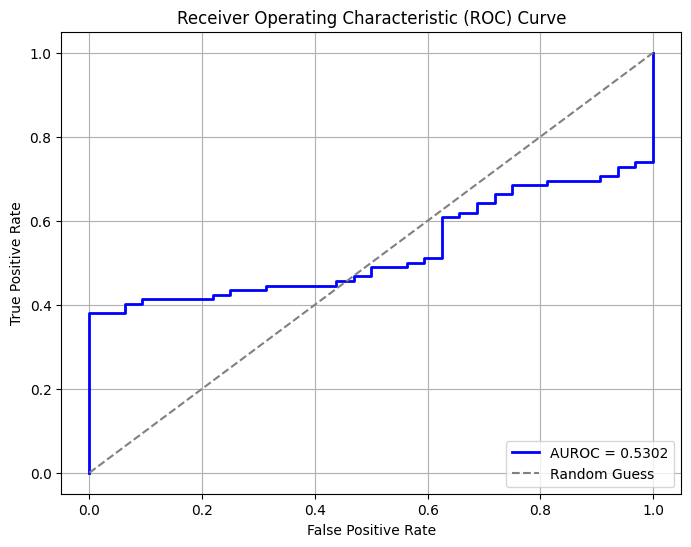

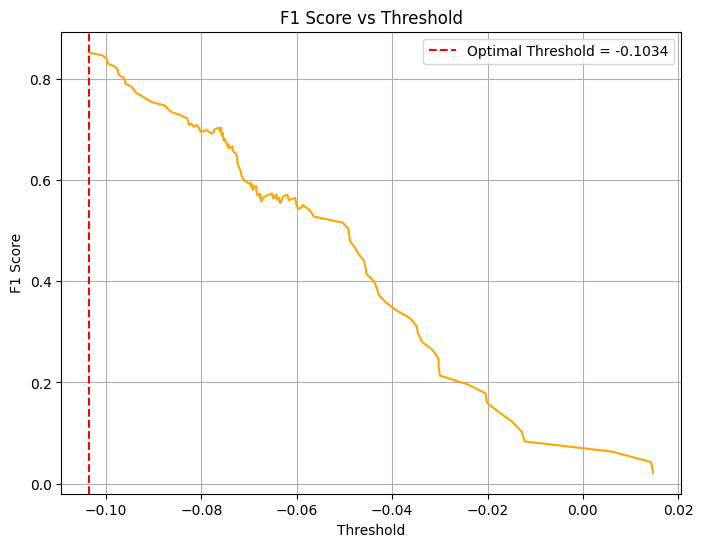

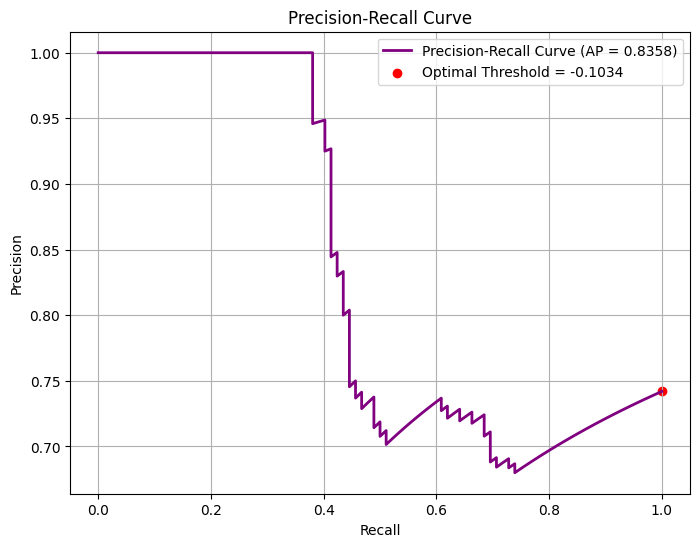

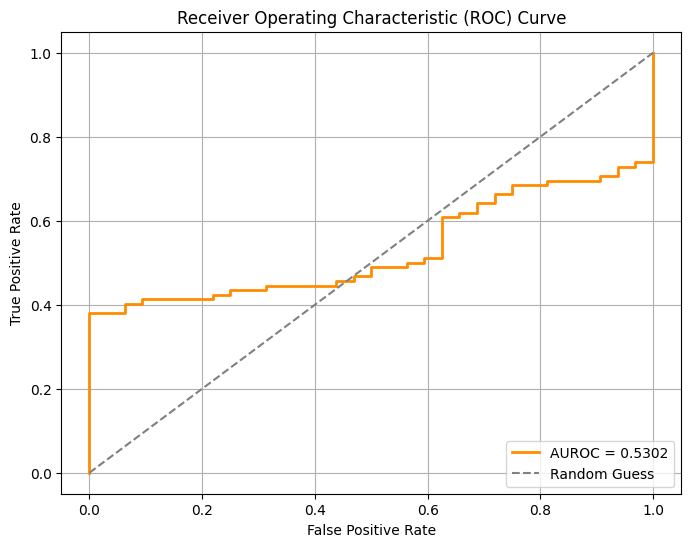

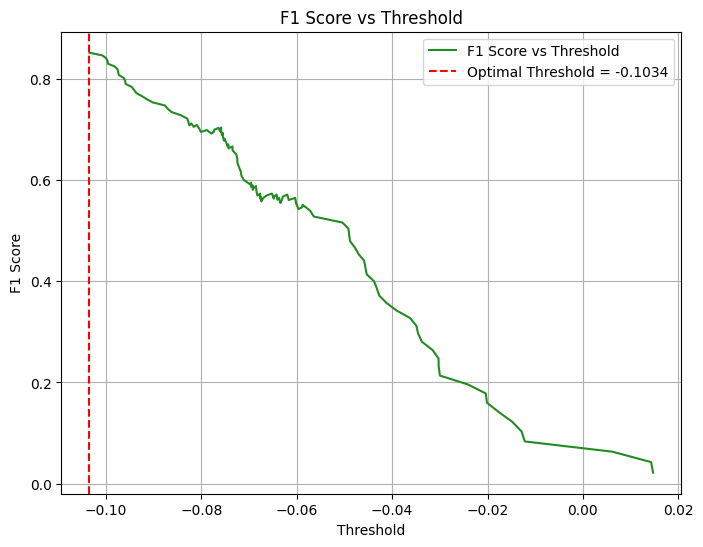

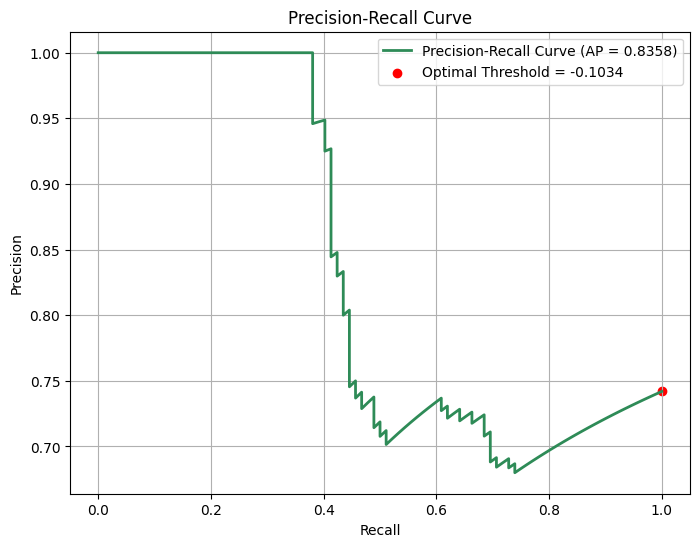

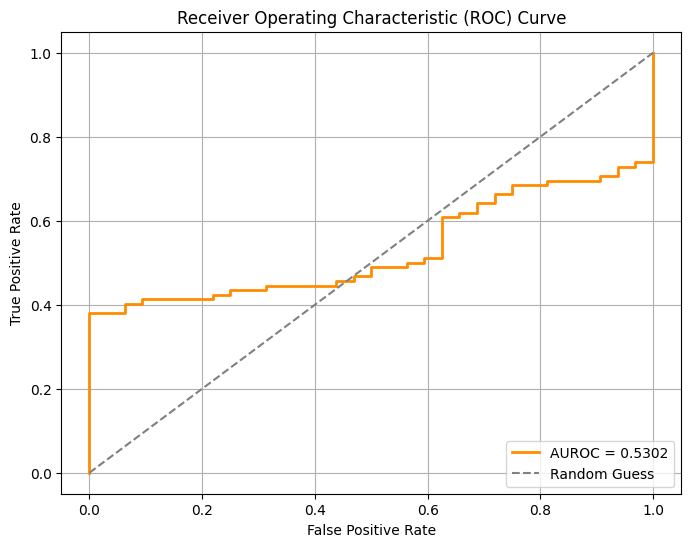

Optimal Threshold: -0.1034
Maximum F1 Score: 0.8519


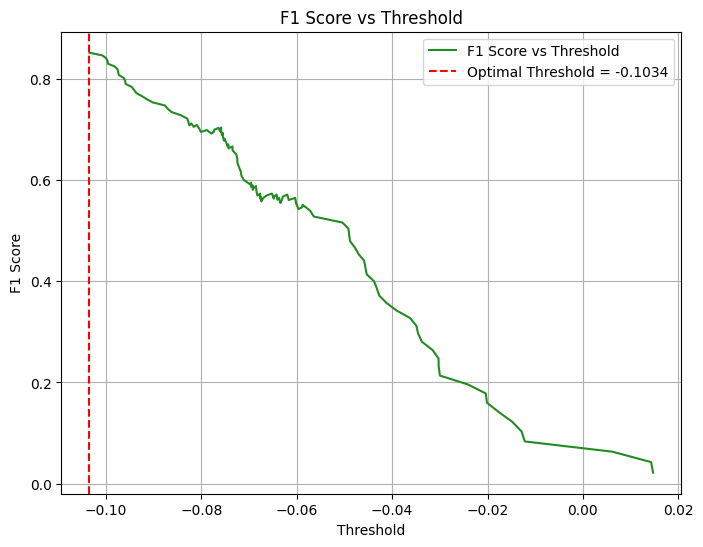

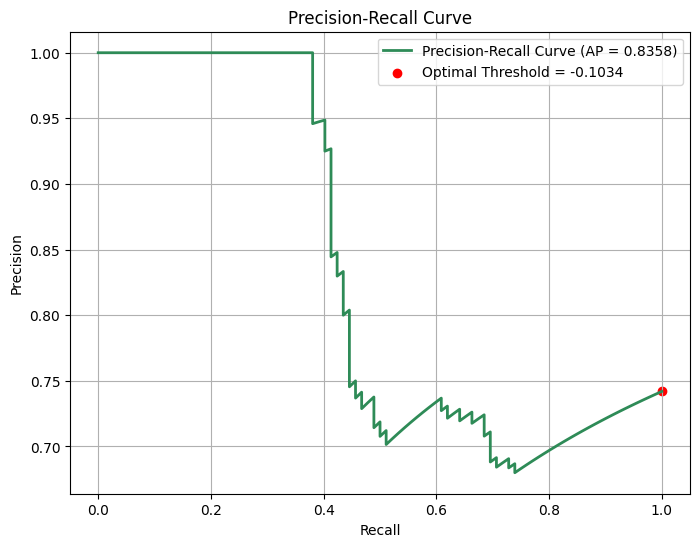

Finished plotting metrics.


In [26]:
%matplotlib inline

import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, precision_recall_curve, average_precision_score, roc_auc_score
import numpy as np

# Initialize a flag to control execution
already_plotted = False

def plot_metrics(true_labels, predicted_scores):
    global already_plotted  # Access the global flag

    # Check if the plots have already been generated
    if already_plotted:
        print("Plots have already been generated. Skipping...")
        return
    else:
        already_plotted = True  # Set the flag to True to prevent re-plotting

    print("Starting to plot metrics...")  # Debugging line
    
    # ------------------- Plot ROC Curve -------------------
    try:
        fpr, tpr, _ = roc_curve(true_labels, predicted_scores)
        plt.figure(figsize=(8, 6))
        plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'AUROC = {roc_auc_score(true_labels, predicted_scores):.4f}')
        plt.plot([0, 1], [0, 1], color='grey', linestyle='--', label='Random Guess')
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title('Receiver Operating Characteristic (ROC) Curve')
        plt.legend(loc="lower right")
        plt.grid(True)
        plt.show()
    except Exception as e:
        print(f"Error plotting ROC Curve: {e}")

    # ------------------- Calculate Precision-Recall Curve -------------------
    precision, recall, thresholds_pr = precision_recall_curve(true_labels, predicted_scores)
    f1_scores = 2 * (precision * recall) / (precision + recall + 1e-8)  # Avoid division by zero

    # Find the optimal threshold (max F1 score)
    optimal_idx = np.argmax(f1_scores)
    optimal_threshold = thresholds_pr[optimal_idx]
    max_f1 = f1_scores[optimal_idx]
    
    # Debugging print statements for thresholds and F1 score
    print(f"Optimal Threshold: {optimal_threshold:.4f}")
    print(f"Maximum F1 Score: {max_f1:.4f}")

    # ------------------- Plot F1 Score vs Threshold -------------------
    plt.figure(figsize=(8, 6))
    plt.plot(thresholds_pr, f1_scores[:-1], color='forestgreen', label="F1 Score vs Threshold")
    plt.axvline(x=optimal_threshold, color='red', linestyle='--', label=f'Optimal Threshold = {optimal_threshold:.4f}')
    plt.xlabel('Threshold')
    plt.ylabel('F1 Score')
    plt.title('F1 Score vs Threshold')
    plt.legend(loc="best")
    plt.grid(True)
    plt.show()

    # ------------------- Plot Precision-Recall Curve -------------------
    plt.figure(figsize=(8, 6))
    plt.plot(recall, precision, color='seagreen', lw=2, label=f'Precision-Recall Curve (AP = {average_precision_score(true_labels, predicted_scores):.4f})')
    plt.scatter(recall[optimal_idx], precision[optimal_idx], color='red', label=f'Optimal Threshold = {optimal_threshold:.4f}')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Precision-Recall Curve')
    plt.legend(loc="upper right")
    plt.grid(True)
    plt.show()

    print("Finished plotting metrics.")  # Debugging line

# Call the function to plot metrics
plot_metrics(true_labels, predicted_scores)


### Overview:
This code performs the following steps:
1. **Feature Extraction**: Features are extracted from a set of training images by resizing each image to 64x64 pixels and then flattening it into a 1D array.
2. **Cosine Similarity Calculation**: For each test image, the cosine similarity between the test image and all training images is calculated.
3. **Top-N Similar Images**: The top N most similar images are identified based on the cosine similarity score.
4. **Display Similar Images**: The code displays the test image along with the most similar images from the training set.

### Functions:

1. **`extract_features()`**:
   - **Input**: Path to the directory containing the images.
   - **Output**: A list of feature vectors (flattened image arrays) for each image and the corresponding image file paths.
   - **Process**:
     - For each image in the directory, it is opened, converted to grayscale, resized to 64x64 pixels, and then flattened into a 1D array.
     - These flattened arrays (features) are collected in a list.

2. **`find_similar_images_for_directory()`**:
   - **Input**: Path to the directory containing test images, a list of extracted features, and corresponding image file paths.
   - **Output**: A dictionary mapping each test image path to its top N most similar images based on cosine similarity.
   - **Process**:
     - For each test image, it is resized and flattened to a 1D array (like the training images).
     - The cosine similarity between the test image's feature vector and each training image's feature vector is calculated using `cosine_similarity()` from `sklearn.metrics.pairwise`.
     - The indices of the most similar images are sorted, and the top N similar images are stored.

3. **`display_similar_images()`**:
   - **Input**: A dictionary of test images and their corresponding similar images.
   - **Output**: Displays the test image and the top N similar images.
   - **Process**:
     - For each test image, the image is displayed alongside its most similar images. This is done using `matplotlib` to show all the images in a single row.

### Detailed Steps:

1. **Loading and Extracting Features**:
   - The training images are loaded from the "train/good" folder of the `mvtec_ad` dataset (specifically for the "leather" category).
   - Each image is resized to 64x64 pixels and flattened into a 1D array, which is then used as the feature vector for that image.
   
2. **Finding Similar Images**:
   - The function `find_similar_images_for_directory()` processes each image from the "test/good" directory.
   - For each test image, it calculates the cosine similarity with all the training images' feature vectors.
   - The top 5 most similar images are stored and associated with the test image.

3. **Displaying the Results**:
   - For each test image, it displays the image along with the 5 most similar images from the training set.
   - All the images are displayed in a row using `matplotlib`, and the titles indicate whether the image is the "Test Image" or one of the "Similar Images."

### Example Output:
For each test image, the following steps occur:
1. The **test image** is displayed.
2. The **top 5 similar images** from the training set are displayed alongside the test image.

### Expected Output:

- **Printed Output**:
  - Paths of the test image and its 5 most similar images.
  - Debugging messages showing any errors encountered during image processing (if any).
  
- **Visual Output**:
  - A single row of 6 images: the test image followed by the 5 most similar images.

Extracted features from 245 training images.

Test Image: /kaggle/working/mvtec_ad/leather/test/good/002.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/193.png
 - /kaggle/working/mvtec_ad/leather/train/good/199.png
 - /kaggle/working/mvtec_ad/leather/train/good/179.png
 - /kaggle/working/mvtec_ad/leather/train/good/190.png
 - /kaggle/working/mvtec_ad/leather/train/good/183.png


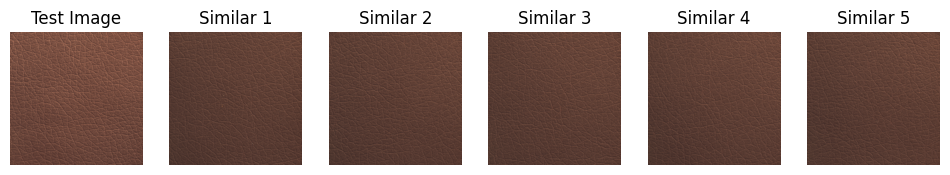


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/010.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/179.png
 - /kaggle/working/mvtec_ad/leather/train/good/193.png
 - /kaggle/working/mvtec_ad/leather/train/good/199.png
 - /kaggle/working/mvtec_ad/leather/train/good/190.png
 - /kaggle/working/mvtec_ad/leather/train/good/109.png


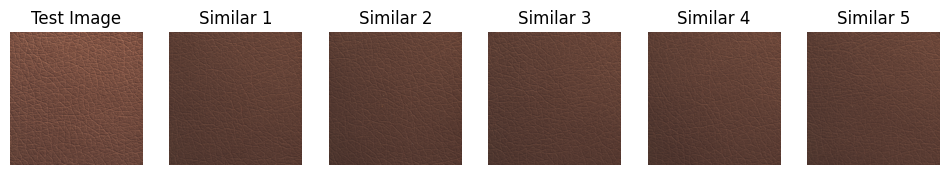


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/009.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/179.png
 - /kaggle/working/mvtec_ad/leather/train/good/193.png
 - /kaggle/working/mvtec_ad/leather/train/good/044.png
 - /kaggle/working/mvtec_ad/leather/train/good/109.png
 - /kaggle/working/mvtec_ad/leather/train/good/168.png


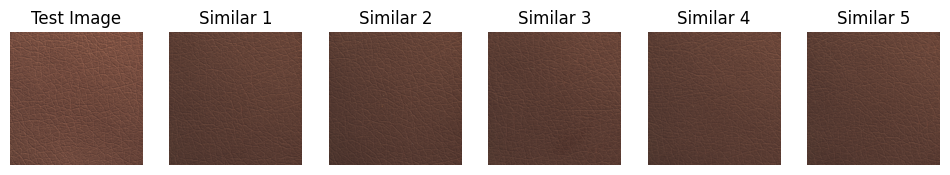


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/015.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/193.png
 - /kaggle/working/mvtec_ad/leather/train/good/179.png
 - /kaggle/working/mvtec_ad/leather/train/good/199.png
 - /kaggle/working/mvtec_ad/leather/train/good/195.png
 - /kaggle/working/mvtec_ad/leather/train/good/109.png


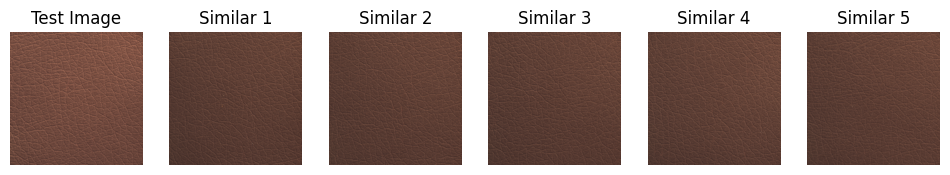


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/001.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/199.png
 - /kaggle/working/mvtec_ad/leather/train/good/193.png
 - /kaggle/working/mvtec_ad/leather/train/good/179.png
 - /kaggle/working/mvtec_ad/leather/train/good/212.png
 - /kaggle/working/mvtec_ad/leather/train/good/143.png


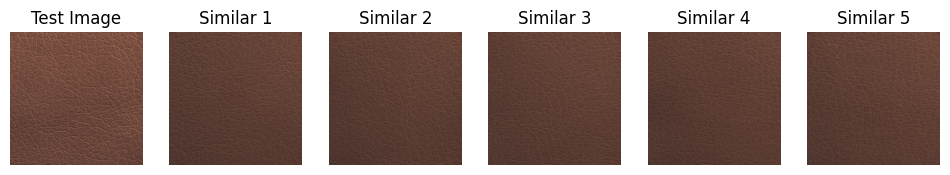


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/011.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/193.png
 - /kaggle/working/mvtec_ad/leather/train/good/199.png
 - /kaggle/working/mvtec_ad/leather/train/good/179.png
 - /kaggle/working/mvtec_ad/leather/train/good/143.png
 - /kaggle/working/mvtec_ad/leather/train/good/109.png


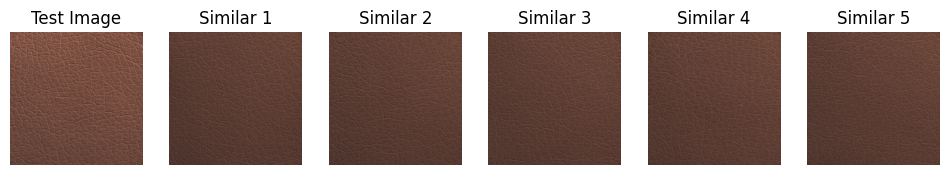


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/008.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/193.png
 - /kaggle/working/mvtec_ad/leather/train/good/179.png
 - /kaggle/working/mvtec_ad/leather/train/good/199.png
 - /kaggle/working/mvtec_ad/leather/train/good/190.png
 - /kaggle/working/mvtec_ad/leather/train/good/109.png


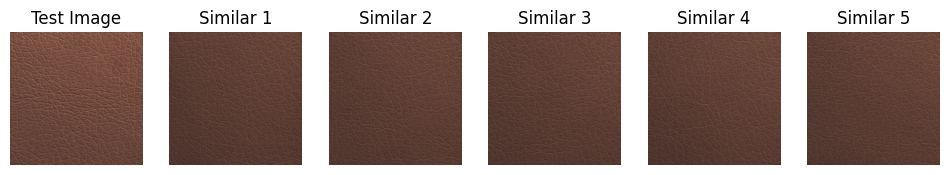


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/028.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/199.png
 - /kaggle/working/mvtec_ad/leather/train/good/179.png
 - /kaggle/working/mvtec_ad/leather/train/good/195.png
 - /kaggle/working/mvtec_ad/leather/train/good/193.png
 - /kaggle/working/mvtec_ad/leather/train/good/109.png


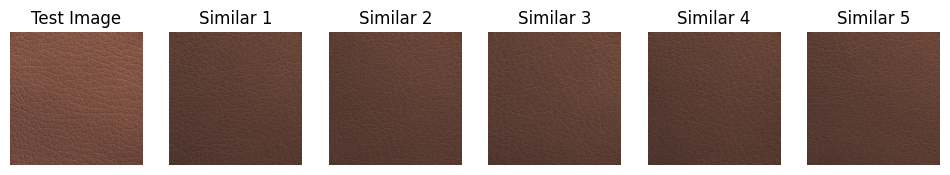


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/003.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/174.png
 - /kaggle/working/mvtec_ad/leather/train/good/199.png
 - /kaggle/working/mvtec_ad/leather/train/good/190.png
 - /kaggle/working/mvtec_ad/leather/train/good/193.png
 - /kaggle/working/mvtec_ad/leather/train/good/179.png


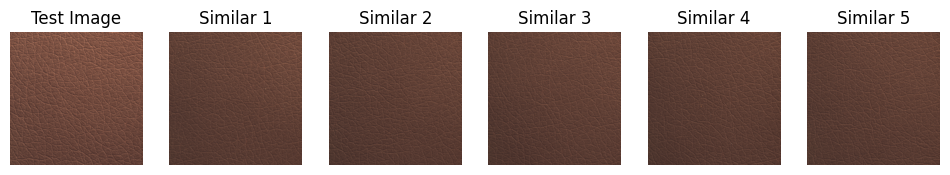


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/031.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/179.png
 - /kaggle/working/mvtec_ad/leather/train/good/193.png
 - /kaggle/working/mvtec_ad/leather/train/good/199.png
 - /kaggle/working/mvtec_ad/leather/train/good/109.png
 - /kaggle/working/mvtec_ad/leather/train/good/190.png


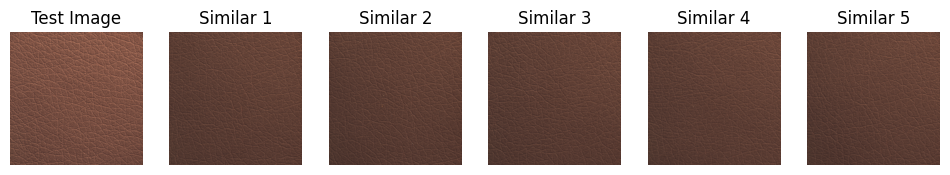


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/004.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/179.png
 - /kaggle/working/mvtec_ad/leather/train/good/199.png
 - /kaggle/working/mvtec_ad/leather/train/good/109.png
 - /kaggle/working/mvtec_ad/leather/train/good/193.png
 - /kaggle/working/mvtec_ad/leather/train/good/168.png


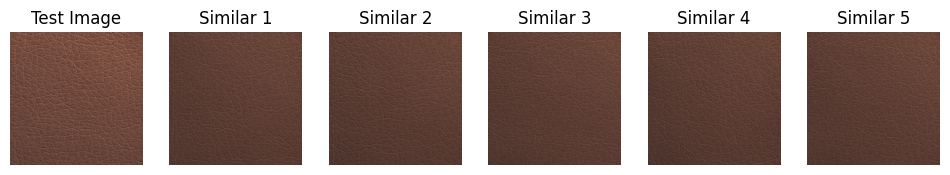


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/014.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/199.png
 - /kaggle/working/mvtec_ad/leather/train/good/179.png
 - /kaggle/working/mvtec_ad/leather/train/good/193.png
 - /kaggle/working/mvtec_ad/leather/train/good/195.png
 - /kaggle/working/mvtec_ad/leather/train/good/166.png


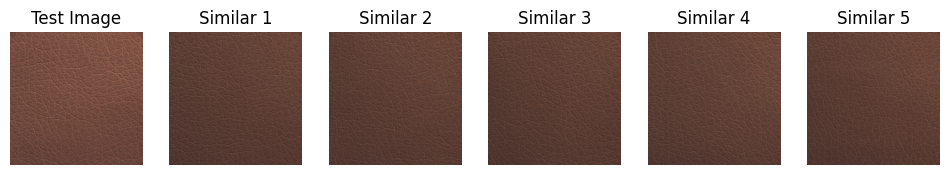


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/013.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/190.png
 - /kaggle/working/mvtec_ad/leather/train/good/086.png
 - /kaggle/working/mvtec_ad/leather/train/good/189.png
 - /kaggle/working/mvtec_ad/leather/train/good/001.png
 - /kaggle/working/mvtec_ad/leather/train/good/199.png


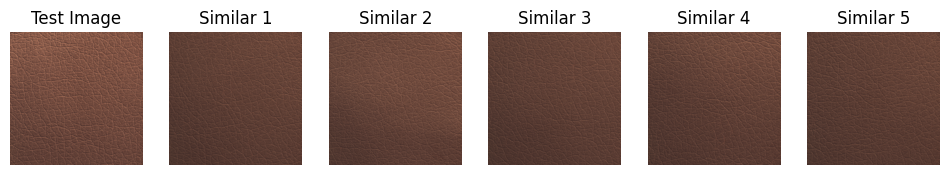


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/019.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/199.png
 - /kaggle/working/mvtec_ad/leather/train/good/179.png
 - /kaggle/working/mvtec_ad/leather/train/good/193.png
 - /kaggle/working/mvtec_ad/leather/train/good/166.png
 - /kaggle/working/mvtec_ad/leather/train/good/190.png


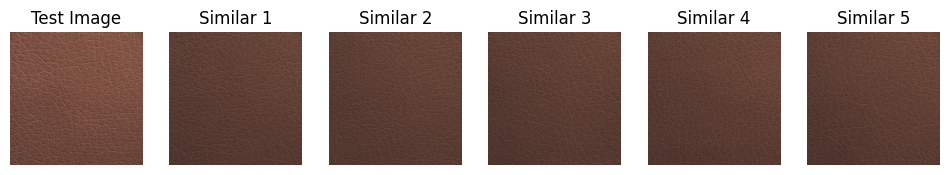


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/018.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/179.png
 - /kaggle/working/mvtec_ad/leather/train/good/193.png
 - /kaggle/working/mvtec_ad/leather/train/good/199.png
 - /kaggle/working/mvtec_ad/leather/train/good/183.png
 - /kaggle/working/mvtec_ad/leather/train/good/109.png


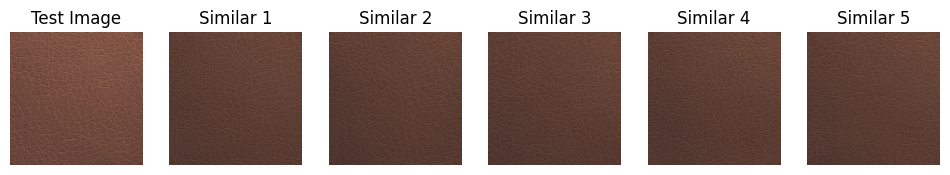


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/012.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/193.png
 - /kaggle/working/mvtec_ad/leather/train/good/190.png
 - /kaggle/working/mvtec_ad/leather/train/good/199.png
 - /kaggle/working/mvtec_ad/leather/train/good/179.png
 - /kaggle/working/mvtec_ad/leather/train/good/174.png


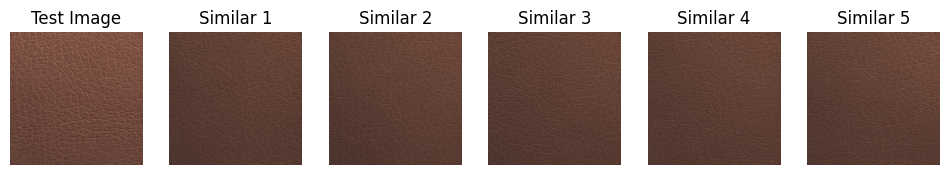


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/026.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/193.png
 - /kaggle/working/mvtec_ad/leather/train/good/179.png
 - /kaggle/working/mvtec_ad/leather/train/good/199.png
 - /kaggle/working/mvtec_ad/leather/train/good/109.png
 - /kaggle/working/mvtec_ad/leather/train/good/212.png


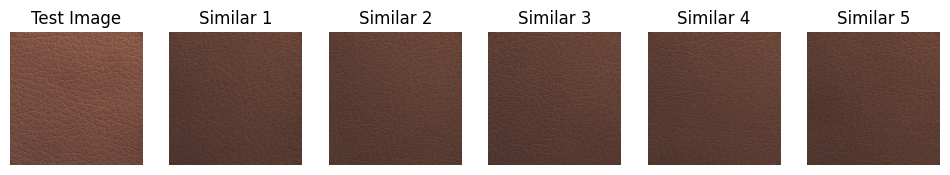


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/027.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/193.png
 - /kaggle/working/mvtec_ad/leather/train/good/179.png
 - /kaggle/working/mvtec_ad/leather/train/good/199.png
 - /kaggle/working/mvtec_ad/leather/train/good/109.png
 - /kaggle/working/mvtec_ad/leather/train/good/212.png


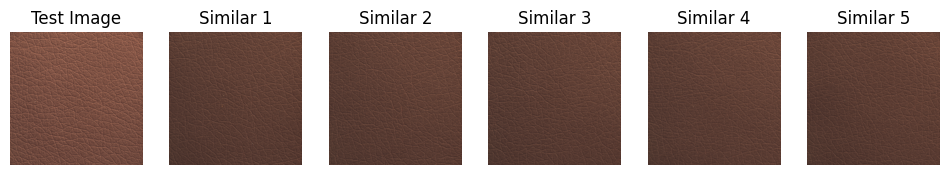


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/020.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/179.png
 - /kaggle/working/mvtec_ad/leather/train/good/199.png
 - /kaggle/working/mvtec_ad/leather/train/good/193.png
 - /kaggle/working/mvtec_ad/leather/train/good/166.png
 - /kaggle/working/mvtec_ad/leather/train/good/195.png


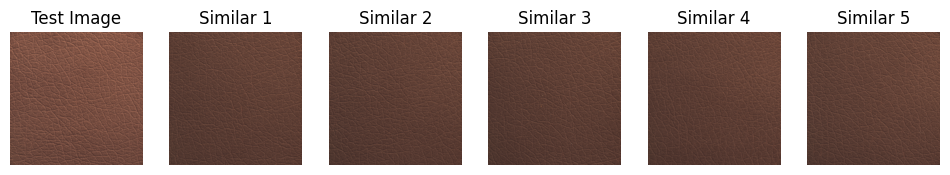


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/007.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/193.png
 - /kaggle/working/mvtec_ad/leather/train/good/086.png
 - /kaggle/working/mvtec_ad/leather/train/good/199.png
 - /kaggle/working/mvtec_ad/leather/train/good/190.png
 - /kaggle/working/mvtec_ad/leather/train/good/189.png


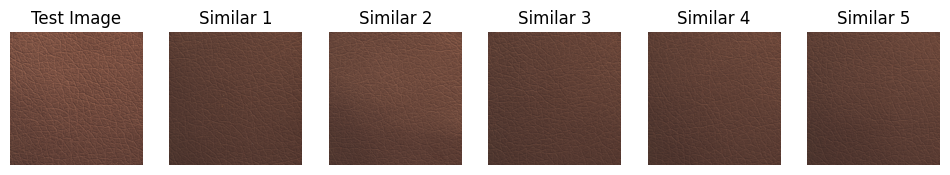


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/000.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/122.png
 - /kaggle/working/mvtec_ad/leather/train/good/179.png
 - /kaggle/working/mvtec_ad/leather/train/good/230.png
 - /kaggle/working/mvtec_ad/leather/train/good/076.png
 - /kaggle/working/mvtec_ad/leather/train/good/191.png


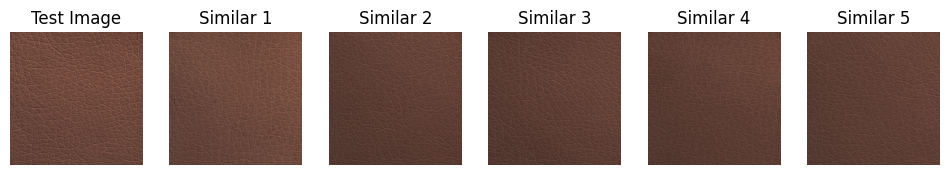


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/017.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/199.png
 - /kaggle/working/mvtec_ad/leather/train/good/179.png
 - /kaggle/working/mvtec_ad/leather/train/good/174.png
 - /kaggle/working/mvtec_ad/leather/train/good/193.png
 - /kaggle/working/mvtec_ad/leather/train/good/166.png


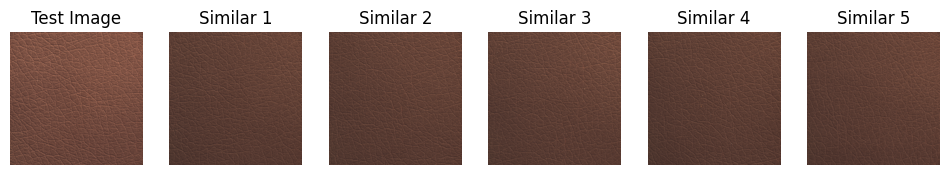


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/006.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/179.png
 - /kaggle/working/mvtec_ad/leather/train/good/193.png
 - /kaggle/working/mvtec_ad/leather/train/good/199.png
 - /kaggle/working/mvtec_ad/leather/train/good/190.png
 - /kaggle/working/mvtec_ad/leather/train/good/166.png


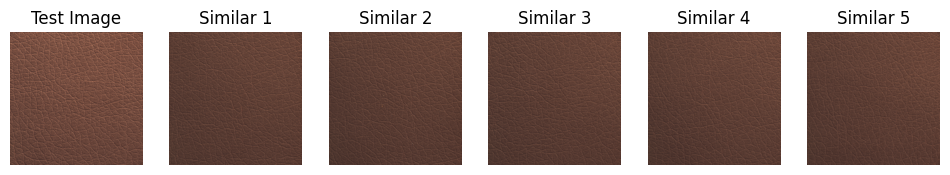


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/030.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/212.png
 - /kaggle/working/mvtec_ad/leather/train/good/179.png
 - /kaggle/working/mvtec_ad/leather/train/good/193.png
 - /kaggle/working/mvtec_ad/leather/train/good/109.png
 - /kaggle/working/mvtec_ad/leather/train/good/165.png


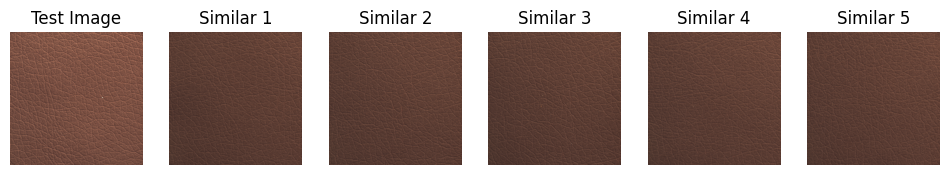


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/022.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/179.png
 - /kaggle/working/mvtec_ad/leather/train/good/165.png
 - /kaggle/working/mvtec_ad/leather/train/good/109.png
 - /kaggle/working/mvtec_ad/leather/train/good/242.png
 - /kaggle/working/mvtec_ad/leather/train/good/195.png


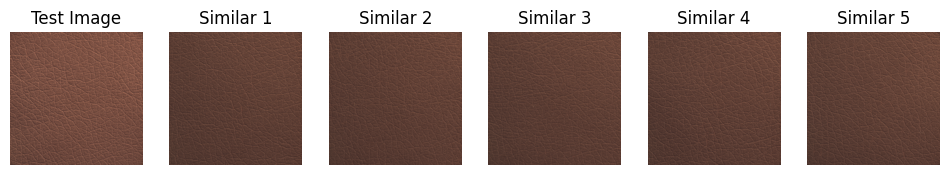


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/021.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/199.png
 - /kaggle/working/mvtec_ad/leather/train/good/179.png
 - /kaggle/working/mvtec_ad/leather/train/good/166.png
 - /kaggle/working/mvtec_ad/leather/train/good/174.png
 - /kaggle/working/mvtec_ad/leather/train/good/226.png


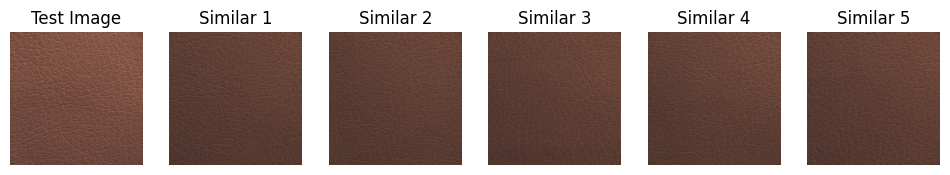


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/025.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/179.png
 - /kaggle/working/mvtec_ad/leather/train/good/199.png
 - /kaggle/working/mvtec_ad/leather/train/good/193.png
 - /kaggle/working/mvtec_ad/leather/train/good/195.png
 - /kaggle/working/mvtec_ad/leather/train/good/183.png


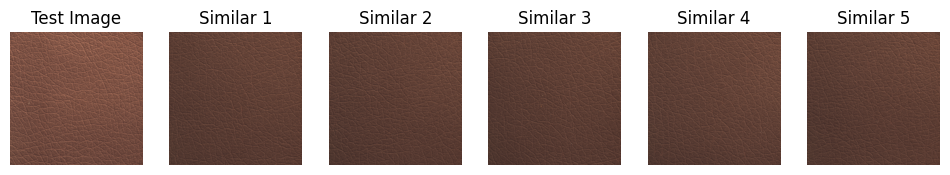


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/024.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/179.png
 - /kaggle/working/mvtec_ad/leather/train/good/199.png
 - /kaggle/working/mvtec_ad/leather/train/good/193.png
 - /kaggle/working/mvtec_ad/leather/train/good/212.png
 - /kaggle/working/mvtec_ad/leather/train/good/165.png


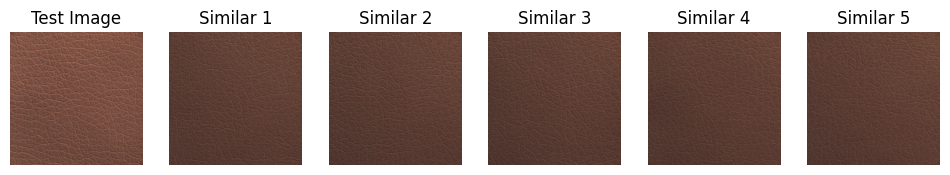


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/023.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/179.png
 - /kaggle/working/mvtec_ad/leather/train/good/199.png
 - /kaggle/working/mvtec_ad/leather/train/good/168.png
 - /kaggle/working/mvtec_ad/leather/train/good/193.png
 - /kaggle/working/mvtec_ad/leather/train/good/109.png


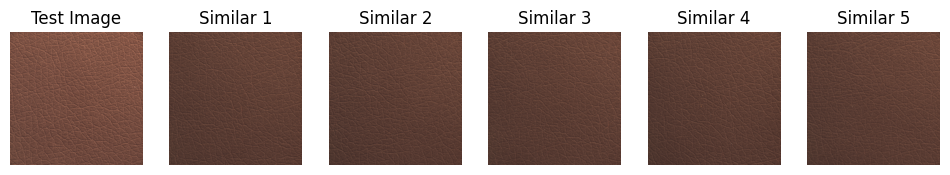


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/005.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/193.png
 - /kaggle/working/mvtec_ad/leather/train/good/162.png
 - /kaggle/working/mvtec_ad/leather/train/good/001.png
 - /kaggle/working/mvtec_ad/leather/train/good/183.png
 - /kaggle/working/mvtec_ad/leather/train/good/229.png


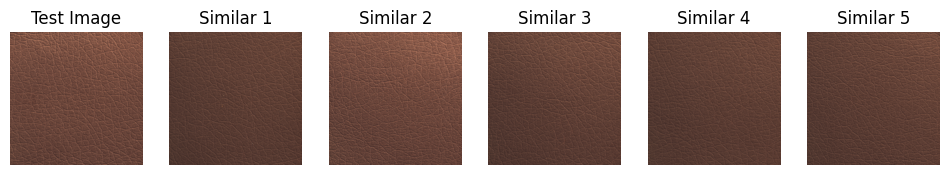


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/029.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/179.png
 - /kaggle/working/mvtec_ad/leather/train/good/193.png
 - /kaggle/working/mvtec_ad/leather/train/good/199.png
 - /kaggle/working/mvtec_ad/leather/train/good/183.png
 - /kaggle/working/mvtec_ad/leather/train/good/109.png


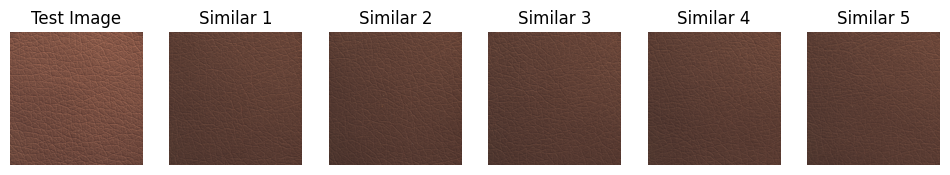


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/leather/test/good/016.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/leather/train/good/199.png
 - /kaggle/working/mvtec_ad/leather/train/good/193.png
 - /kaggle/working/mvtec_ad/leather/train/good/179.png
 - /kaggle/working/mvtec_ad/leather/train/good/195.png
 - /kaggle/working/mvtec_ad/leather/train/good/166.png


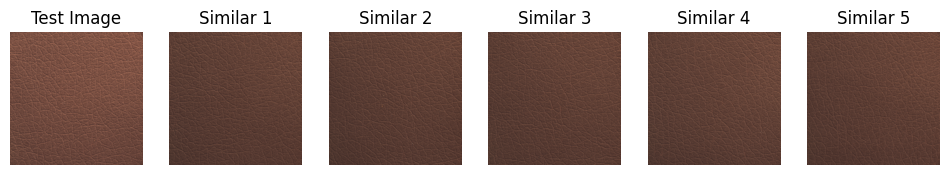


--------------------------------------------------



In [27]:
import os
import numpy as np
from PIL import Image
from sklearn.metrics.pairwise import cosine_similarity
import matplotlib.pyplot as plt

# Define dataset path (updated for Kaggle environment)
dataset_path = '/kaggle/working/mvtec_ad/leather'

def extract_features(images_path):
    """Extract features from the images by resizing and flattening them."""
    features = []
    image_files = []
    for img_name in os.listdir(images_path):
        img_path = os.path.join(images_path, img_name)
        # Filter out non-image files
        if img_name.lower().endswith((".png", ".jpg", ".jpeg", ".bmp", ".tiff")):
            try:
                img = Image.open(img_path).convert("L")  # Convert image to grayscale
                img_resized = img.resize((64, 64))  # Resize image to 64x64
                img_array = np.array(img_resized).flatten()  # Flatten image to a 1D array
                features.append(img_array)
                image_files.append(img_path)
            except Exception as e:
                print(f"Error processing image {img_path}: {e}")
                continue
    return np.array(features), image_files

def find_similar_images_for_directory(test_images_path, features, image_files, top_n=5):
    """Find similar images from the test set based on cosine similarity."""
    test_results = {}
    for img_name in os.listdir(test_images_path):
        img_path = os.path.join(test_images_path, img_name)
        # Filter out non-image files
        if img_name.lower().endswith((".png", ".jpg", ".jpeg", ".bmp", ".tiff")):
            try:
                input_image = Image.open(img_path).convert("L")
                input_image_resized = input_image.resize((64, 64))
                input_features = np.array(input_image_resized).flatten().reshape(1, -1)
                
                similarities = cosine_similarity(input_features, features).flatten()
                similar_indices = similarities.argsort()[-top_n:][::-1]
                
                similar_images = [image_files[i] for i in similar_indices]
                test_results[img_path] = similar_images
            except Exception as e:
                print(f"Error processing test image {img_path}: {e}")
                continue
    return test_results

def display_similar_images(test_results):
    """Display the test image and its most similar images."""
    if not test_results:
        print("No similar images found to display.")
        return
    
    for test_image, similar_images in test_results.items():
        # Print the test image and similar images paths
        print(f"Test Image: {test_image}")
        print("Top 5 similar images:")
        for img_path in similar_images:
            print(f" - {img_path}")
        
        # Display the images in a row (Test image + Top similar images)
        plt.figure(figsize=(12, 2))  # Adjust figure size as needed
        
        # Display the test image
        test_img = Image.open(test_image)
        plt.subplot(1, 6, 1)
        plt.imshow(test_img, cmap='gray')
        plt.axis('off')
        plt.title("Test Image")
        
        # Display each similar image
        for i, img_path in enumerate(similar_images):
            similar_img = Image.open(img_path)
            plt.subplot(1, 6, i + 2)
            plt.imshow(similar_img, cmap='gray')
            plt.axis('off')
            plt.title(f"Similar {i+1}")
        
        plt.show()
        print("\n" + "-" * 50 + "\n")  # Separator for readability

# Load images and extract features from the training data
train_images_path = os.path.join(dataset_path, "train/good")
features, image_files = extract_features(train_images_path)
print(f"Extracted features from {len(image_files)} training images.\n")

# Specify path to test images and display similar images
test_images_path = os.path.join(dataset_path, "test/good")
similar_images_results = find_similar_images_for_directory(test_images_path, features, image_files)
display_similar_images(similar_images_results)


In [31]:
# Import the required modules
from anomalib.data import MVTec
from anomalib.models import EfficientAd
from anomalib.engine import Engine
from sklearn.metrics import roc_auc_score, roc_curve
import numpy as np
import os
from PIL import Image
import matplotlib.pyplot as plt

# Define paths
checkpoint_path = '/kaggle/working/anomalib_checkpoints'  # Currently no checkpoint is available

# Initialize the datamodule, model, and engine
datamodule = MVTec(root=dataset_path, train_batch_size=1, category="grid")  # Adjust categories as needed
model = EfficientAd()
engine = Engine(max_epochs=5)

# Train the model (without checkpoint as it's not available)
engine.fit(datamodule=datamodule, model=model)


INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]
INFO: 
  | Name                  | Type                     | Params | Mode 
---------------------------------------------------------------------------
0 | model                 | EfficientAdModel         | 8.1 M  | train
1 | _transform            | Compose                  | 0      | train
2 | normalization_metrics | MetricCollection         | 0      | train
3 | image_threshold       | F1AdaptiveThreshold      | 0      | train
4 | pixel_threshold       | F1AdaptiveThreshold      | 0      | train
5 | image_metrics         | AnomalibMetricCollection | 0      | train
6 | pixel_metrics         | AnomalibMetricCollection | 0      | train
---------------------------------------------------------------------------
8.1 M     Trainable params
0         Non-trainable params
8.1 M     Total params
32.235    Total estimated model params size (MB)
46        Modules in train mode
7         Modules in eval mode


Training: |          | 0/? [00:00<?, ?it/s]

Calculate teacher channel mean & std: 100%|██████████| 264/264 [00:04<00:00, 56.42it/s]


Validation: |          | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles: 100%|██████████| 3/3 [00:03<00:00,  1.07s/it]


Validation: |          | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles: 100%|██████████| 3/3 [00:03<00:00,  1.09s/it]


Validation: |          | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles: 100%|██████████| 3/3 [00:03<00:00,  1.04s/it]


Validation: |          | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles: 100%|██████████| 3/3 [00:03<00:00,  1.08s/it]


Validation: |          | 0/? [00:00<?, ?it/s]

Calculate Validation Dataset Quantiles: 100%|██████████| 3/3 [00:03<00:00,  1.07s/it]


In [32]:
import torch
import torchvision.transforms as transforms
import warnings
from sklearn.metrics import roc_auc_score, roc_curve, f1_score, confusion_matrix, precision_recall_curve, average_precision_score
import matplotlib.pyplot as plt
import numpy as np

# Suppress specific warnings
warnings.filterwarnings("ignore", category=FutureWarning)
warnings.filterwarnings("ignore", category=UserWarning)

# Define ImageNet normalization (if needed for batch_imagenet)
imagenet_normalization = transforms.Normalize(
    mean=[0.485, 0.456, 0.406],
    std=[0.229, 0.224, 0.225]
)

# --------------------- Evaluation and Metrics Computation ---------------------

# Evaluate the model on the test set
print("Evaluating the model on the test set...")
engine.test(datamodule=datamodule, model=model)
print("Evaluation completed.\n")

# Initialize lists to collect true labels and predicted anomaly scores
true_labels = []
predicted_scores = []

# Set model to evaluation mode
model.eval()

# Disable gradient calculations for inference
with torch.no_grad():
    # Loop over the test dataset to gather labels and anomaly scores
    for batch_idx, batch in enumerate(datamodule.test_dataloader()):
        try:
            images = batch['image'].to(model.device)
            labels = batch['label'].cpu().numpy()
            true_labels.extend(labels)

            # Apply ImageNet normalization
            batch_imagenet = imagenet_normalization(images)

            # Forward pass through the model to get predictions
            outputs = model(batch=images, batch_imagenet=batch_imagenet, normalize=True)
            
            if 'anomaly_map' not in outputs:
                raise KeyError("Model output does not contain 'anomaly_map'.")

            # Aggregate anomaly scores (mean across spatial dimensions)
            anomaly_scores = outputs['anomaly_map'].cpu().numpy().mean(axis=(1, 2, 3))
            predicted_scores.extend(anomaly_scores)
            
            print(f"Processed batch {batch_idx + 1} successfully.\n")
        
        except Exception as e:
            print(f"Error processing batch {batch_idx + 1}: {e}\n")
            continue

# Convert lists to numpy arrays for processing
true_labels = np.array(true_labels).flatten()
predicted_scores = np.array(predicted_scores).flatten()

# Debugging: Inspect unique classes in true_labels
unique_classes = np.unique(true_labels)
print(f"Number of unique classes in true_labels: {len(unique_classes)}")
print(f"Unique classes in true_labels: {unique_classes}")

# Ensure binary classification
if len(unique_classes) != 2:
    raise ValueError(f"Expected binary classification, but found {len(unique_classes)} classes: {unique_classes}")
else:
    print("\nConfirmed binary classification with classes:", unique_classes)

# Compute AUROC (Area Under ROC Curve)
try:
    auroc = roc_auc_score(true_labels, predicted_scores)
    print(f"\nAUROC Score: {auroc:.4f}")
except ValueError as e:
    print(f"Error computing ROC AUC Score: {e}")

# Plot ROC Curve
try:
    fpr, tpr, _ = roc_curve(true_labels, predicted_scores)
    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, color='blue', lw=2, label=f'AUROC = {auroc:.4f}')
    plt.plot([0, 1], [0, 1], color='grey', linestyle='--', label='Random Guess')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()
except Exception as e:
    print(f"Error plotting ROC Curve: {e}")

# Threshold Analysis
threshold = 0.5
predicted_labels = (predicted_scores > threshold).astype(int)
f1 = f1_score(true_labels, predicted_labels)
print(f"F1 Score with threshold {threshold}: {f1:.4f}")

# Confusion Matrix at threshold 0.5
conf_matrix = confusion_matrix(true_labels, predicted_labels)
print("\nConfusion Matrix at Threshold 0.5:")
print(conf_matrix)
print("\nConfusion Matrix Breakdown:")
print(f"True Negatives: {conf_matrix[0,0]}")
print(f"False Positives: {conf_matrix[0,1]}")
print(f"False Negatives: {conf_matrix[1,0]}")
print(f"True Positives: {conf_matrix[1,1]}")

# Optimal Threshold Calculation
precision, recall, thresholds_pr = precision_recall_curve(true_labels, predicted_scores)
f1_scores = 2 * (precision * recall) / (precision + recall + 1e-8)
optimal_idx = np.argmax(f1_scores)
optimal_threshold = thresholds_pr[optimal_idx]
max_f1 = f1_scores[optimal_idx]

print(f"\nOptimal Threshold based on Precision-Recall Curve: {optimal_threshold:.4f}")
print(f"Maximum F1 Score: {max_f1:.4f}")

# Apply optimal threshold
predicted_labels_optimal = (predicted_scores > optimal_threshold).astype(int)

# Recompute F1 Score at optimal threshold
f1_optimal = f1_score(true_labels, predicted_labels_optimal)
print(f"F1 Score with Optimal Threshold ({optimal_threshold:.4f}): {f1_optimal:.4f}")

# Confusion Matrix at optimal threshold
conf_matrix_optimal = confusion_matrix(true_labels, predicted_labels_optimal)
print("\nConfusion Matrix at Optimal Threshold:")
print(conf_matrix_optimal)
print("\nConfusion Matrix Breakdown at Optimal Threshold:")
print(f"True Negatives: {conf_matrix_optimal[0,0]}")
print(f"False Positives: {conf_matrix_optimal[0,1]}")
print(f"False Negatives: {conf_matrix_optimal[1,0]}")
print(f"True Positives: {conf_matrix_optimal[1,1]}")

# Plot F1 Score vs Threshold
plt.figure(figsize=(8, 6))
plt.plot(thresholds_pr, f1_scores[:-1], color='orange')
plt.axvline(x=optimal_threshold, color='red', linestyle='--', label=f'Optimal Threshold = {optimal_threshold:.4f}')
plt.xlabel('Threshold')
plt.ylabel('F1 Score')
plt.title('F1 Score vs Threshold')
plt.legend(loc="best")
plt.grid(True)
plt.show()

# Plot Precision-Recall Curve
plt.figure(figsize=(8, 6))
plt.plot(recall, precision, color='purple', lw=2, label=f'Precision-Recall Curve (AP = {average_precision_score(true_labels, predicted_scores):.4f})')
plt.scatter(recall[optimal_idx], precision[optimal_idx], color='red', label=f'Optimal Threshold = {optimal_threshold:.4f}')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.legend(loc="upper right")
plt.grid(True)
plt.show()


INFO: LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1]


Evaluating the model on the test set...


Testing: |          | 0/? [00:00<?, ?it/s]

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│        image_AUROC        │    0.9799498915672302     │
│       image_F1Score       │    0.9642857313156128     │
│        pixel_AUROC        │    0.9059211015701294     │
│       pixel_F1Score       │    0.46032485365867615    │
└───────────────────────────┴───────────────────────────┘

Evaluation completed.

Processed batch 1 successfully.

Processed batch 2 successfully.

Processed batch 3 successfully.

Number of unique classes in true_labels: 2
Unique classes in true_labels: [0 1]

Confirmed binary classification with classes: [0 1]

AUROC Score: 0.3768
F1 Score with threshold 0.5: 0.0000

Confusion Matrix at Threshold 0.5:
[[21  0]
 [57  0]]

Confusion Matrix Breakdown:
True Negatives: 21
False Positives: 0
False Negatives: 57
True Positives: 0

Optimal Threshold based on Precision-Recall Curve: -0.2124
Maximum F1 Score: 0.8444
F1 Score with Optimal Threshold (-0.2124): 0.8358

Confusion Matrix at Optimal Threshold:
[[ 0 21]
 [ 1 56]]

Confusion Matrix Breakdown at Optimal Threshold:
True Negatives: 0
False Positives: 21
False Negatives: 1
True Positives: 56


Starting to plot metrics...


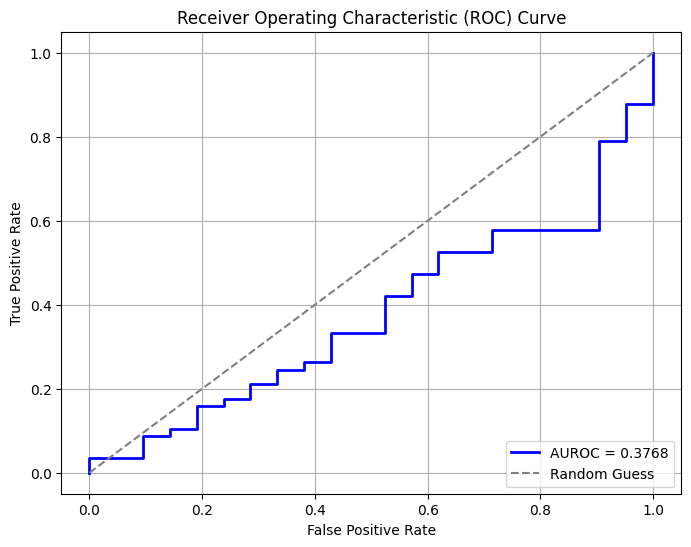

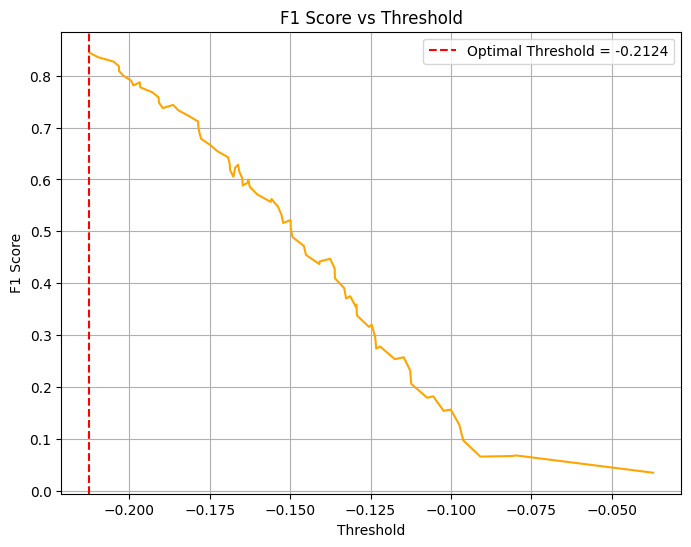

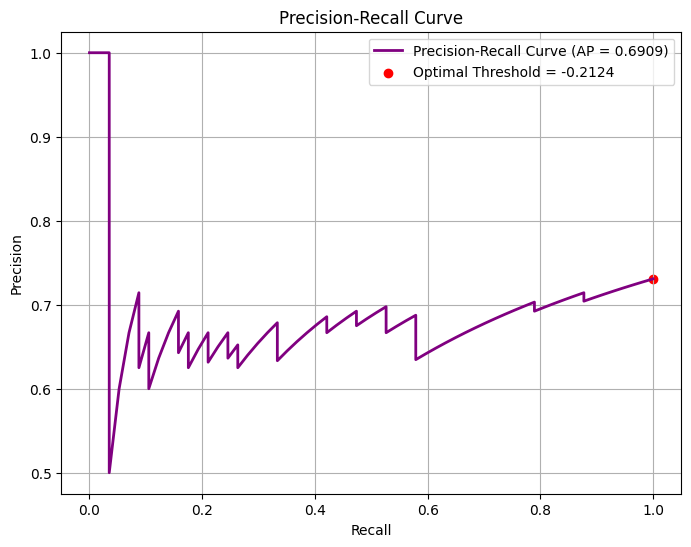

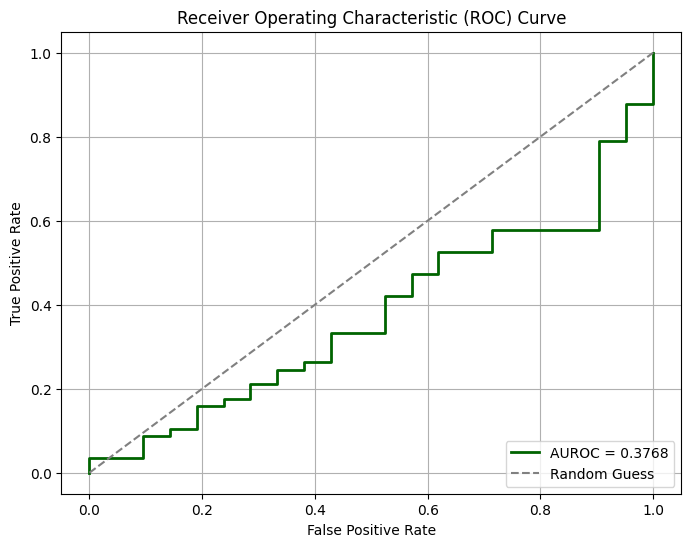

Optimal Threshold: -0.2123924344778061
Maximum F1 Score: 0.844444439565432


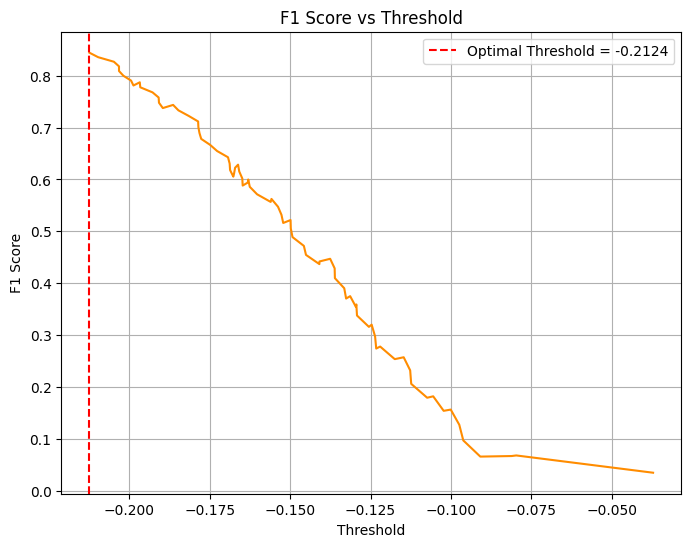

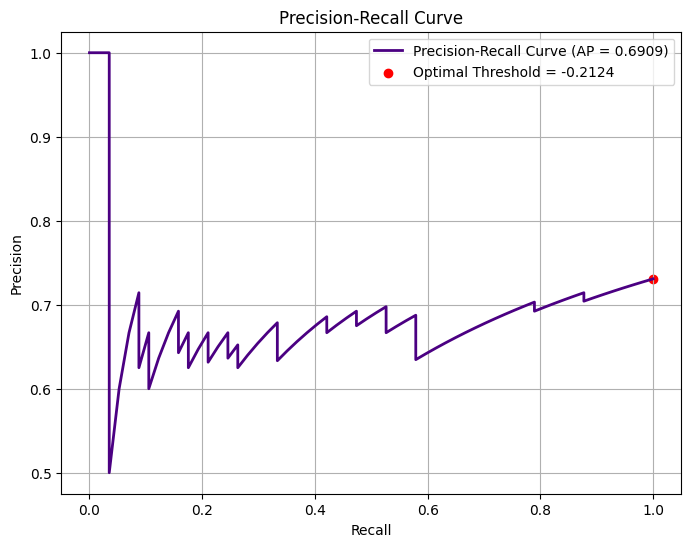

Finished plotting metrics.


In [33]:
%matplotlib inline

import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, precision_recall_curve, average_precision_score, roc_auc_score
import numpy as np

# Initialize a flag to control execution
already_plotted = False

def plot_metrics(true_labels, predicted_scores):
    global already_plotted  # Access the global flag

    # Check if the plots have already been generated
    if already_plotted:
        print("Plots have already been generated. Skipping...")
        return
    else:
        already_plotted = True  # Set the flag to True to prevent re-plotting

    print("Starting to plot metrics...")  # Debugging line
    
    # Plot ROC Curve
    try:
        fpr, tpr, _ = roc_curve(true_labels, predicted_scores)
        plt.figure(figsize=(8, 6))
        plt.plot(fpr, tpr, color='darkgreen', lw=2, label=f'AUROC = {roc_auc_score(true_labels, predicted_scores):.4f}')
        plt.plot([0, 1], [0, 1], color='grey', linestyle='--', label='Random Guess')
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title('Receiver Operating Characteristic (ROC) Curve')
        plt.legend(loc="lower right")
        plt.grid(True)
        plt.show()
    except Exception as e:
        print(f"Error plotting ROC Curve: {e}")

    # Calculate Precision-Recall Curve
    precision, recall, thresholds_pr = precision_recall_curve(true_labels, predicted_scores)
    f1_scores = 2 * (precision * recall) / (precision + recall + 1e-8)

    # Find optimal threshold
    optimal_idx = np.argmax(f1_scores)
    optimal_threshold = thresholds_pr[optimal_idx]
    max_f1 = f1_scores[optimal_idx]
    
    # Debugging print statements for thresholds and F1 score
    print(f"Optimal Threshold: {optimal_threshold}")
    print(f"Maximum F1 Score: {max_f1}")

    # Plot F1 Score vs Threshold
    plt.figure(figsize=(8, 6))
    plt.plot(thresholds_pr, f1_scores[:-1], color='darkorange')
    plt.axvline(x=optimal_threshold, color='red', linestyle='--', label=f'Optimal Threshold = {optimal_threshold:.4f}')
    plt.xlabel('Threshold')
    plt.ylabel('F1 Score')
    plt.title('F1 Score vs Threshold')
    plt.legend(loc="best")
    plt.grid(True)
    plt.show()

    # Plot Precision-Recall Curve
    plt.figure(figsize=(8, 6))
    plt.plot(recall, precision, color='indigo', lw=2, label=f'Precision-Recall Curve (AP = {average_precision_score(true_labels, predicted_scores):.4f})')
    plt.scatter(recall[optimal_idx], precision[optimal_idx], color='red', label=f'Optimal Threshold = {optimal_threshold:.4f}')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Precision-Recall Curve')
    plt.legend(loc="upper right")
    plt.grid(True)
    plt.show()

    # Close all figures to prevent lingering plots in memory
    plt.close('all')

    print("Finished plotting metrics.")  # Debugging line

# Ensure you only call this once
plot_metrics(true_labels, predicted_scores)


Extracted features from 264 training images.

Test Image: /kaggle/working/mvtec_ad/grid/test/good/002.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/grid/train/good/067.png
 - /kaggle/working/mvtec_ad/grid/train/good/025.png
 - /kaggle/working/mvtec_ad/grid/train/good/134.png
 - /kaggle/working/mvtec_ad/grid/train/good/180.png
 - /kaggle/working/mvtec_ad/grid/train/good/079.png


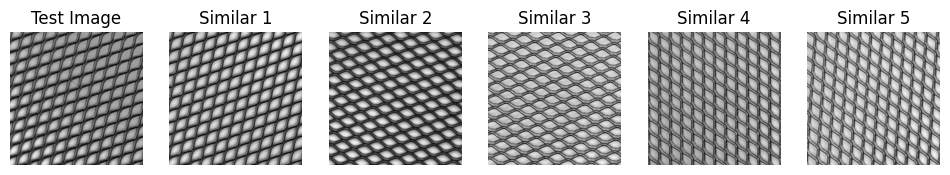


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/grid/test/good/010.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/grid/train/good/173.png
 - /kaggle/working/mvtec_ad/grid/train/good/135.png
 - /kaggle/working/mvtec_ad/grid/train/good/179.png
 - /kaggle/working/mvtec_ad/grid/train/good/134.png
 - /kaggle/working/mvtec_ad/grid/train/good/133.png


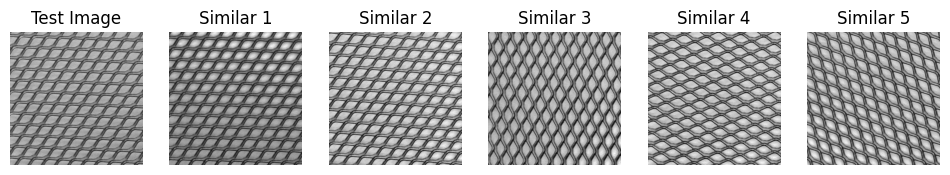


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/grid/test/good/009.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/grid/train/good/009.png
 - /kaggle/working/mvtec_ad/grid/train/good/184.png
 - /kaggle/working/mvtec_ad/grid/train/good/180.png
 - /kaggle/working/mvtec_ad/grid/train/good/104.png
 - /kaggle/working/mvtec_ad/grid/train/good/080.png


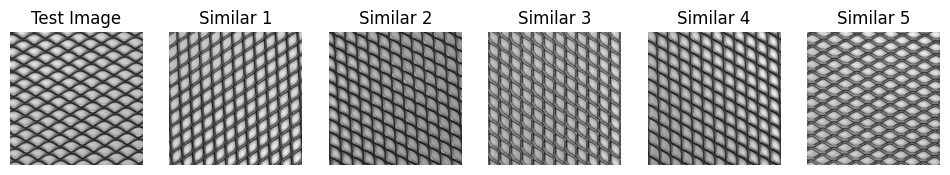


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/grid/test/good/015.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/grid/train/good/206.png
 - /kaggle/working/mvtec_ad/grid/train/good/127.png
 - /kaggle/working/mvtec_ad/grid/train/good/144.png
 - /kaggle/working/mvtec_ad/grid/train/good/040.png
 - /kaggle/working/mvtec_ad/grid/train/good/063.png


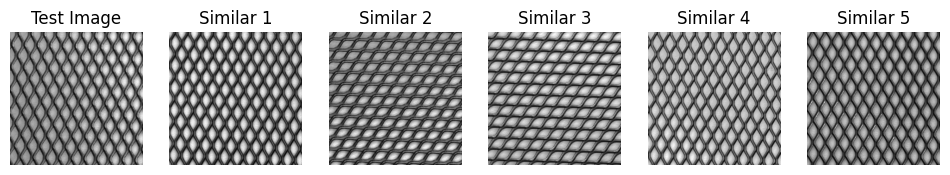


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/grid/test/good/001.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/grid/train/good/221.png
 - /kaggle/working/mvtec_ad/grid/train/good/031.png
 - /kaggle/working/mvtec_ad/grid/train/good/049.png
 - /kaggle/working/mvtec_ad/grid/train/good/134.png
 - /kaggle/working/mvtec_ad/grid/train/good/027.png


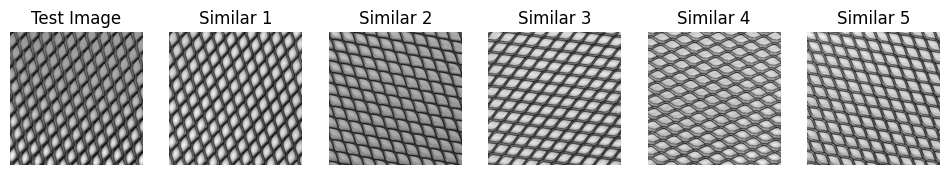


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/grid/test/good/011.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/grid/train/good/079.png
 - /kaggle/working/mvtec_ad/grid/train/good/125.png
 - /kaggle/working/mvtec_ad/grid/train/good/133.png
 - /kaggle/working/mvtec_ad/grid/train/good/135.png
 - /kaggle/working/mvtec_ad/grid/train/good/169.png


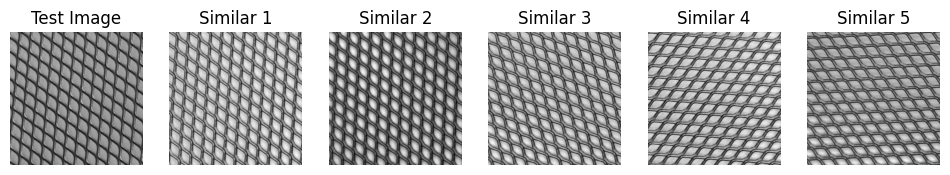


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/grid/test/good/008.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/grid/train/good/046.png
 - /kaggle/working/mvtec_ad/grid/train/good/134.png
 - /kaggle/working/mvtec_ad/grid/train/good/133.png
 - /kaggle/working/mvtec_ad/grid/train/good/119.png
 - /kaggle/working/mvtec_ad/grid/train/good/169.png


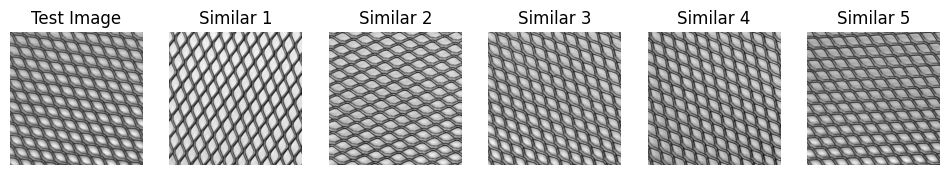


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/grid/test/good/003.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/grid/train/good/129.png
 - /kaggle/working/mvtec_ad/grid/train/good/002.png
 - /kaggle/working/mvtec_ad/grid/train/good/230.png
 - /kaggle/working/mvtec_ad/grid/train/good/048.png
 - /kaggle/working/mvtec_ad/grid/train/good/017.png


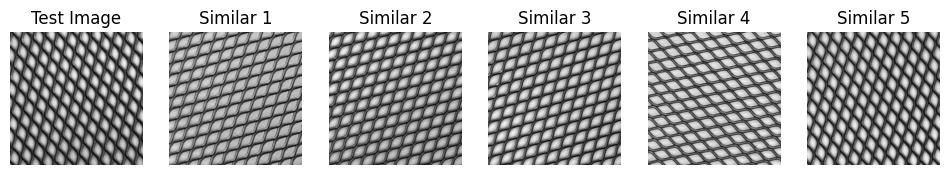


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/grid/test/good/004.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/grid/train/good/030.png
 - /kaggle/working/mvtec_ad/grid/train/good/134.png
 - /kaggle/working/mvtec_ad/grid/train/good/135.png
 - /kaggle/working/mvtec_ad/grid/train/good/119.png
 - /kaggle/working/mvtec_ad/grid/train/good/133.png


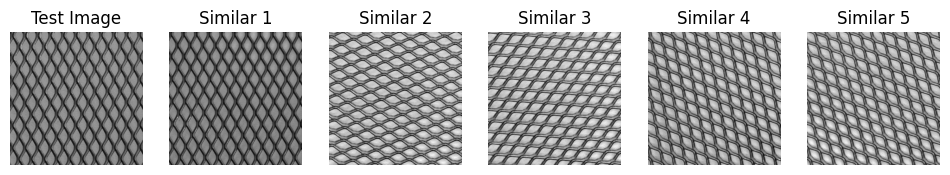


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/grid/test/good/014.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/grid/train/good/080.png
 - /kaggle/working/mvtec_ad/grid/train/good/180.png
 - /kaggle/working/mvtec_ad/grid/train/good/120.png
 - /kaggle/working/mvtec_ad/grid/train/good/109.png
 - /kaggle/working/mvtec_ad/grid/train/good/134.png


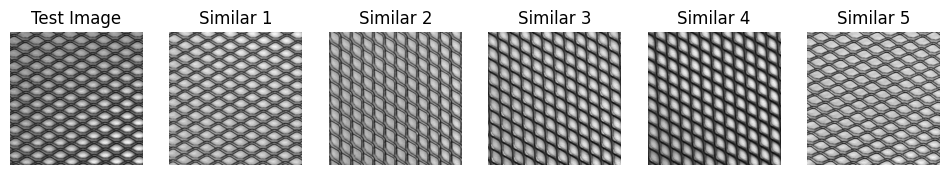


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/grid/test/good/013.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/grid/train/good/007.png
 - /kaggle/working/mvtec_ad/grid/train/good/248.png
 - /kaggle/working/mvtec_ad/grid/train/good/168.png
 - /kaggle/working/mvtec_ad/grid/train/good/247.png
 - /kaggle/working/mvtec_ad/grid/train/good/134.png


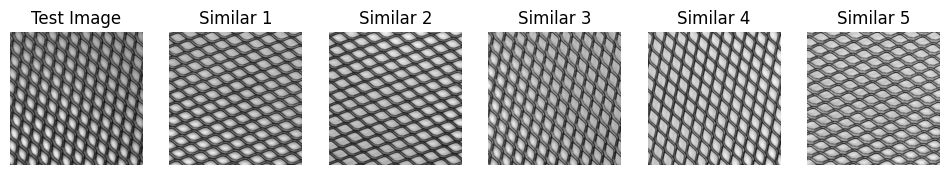


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/grid/test/good/019.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/grid/train/good/147.png
 - /kaggle/working/mvtec_ad/grid/train/good/134.png
 - /kaggle/working/mvtec_ad/grid/train/good/135.png
 - /kaggle/working/mvtec_ad/grid/train/good/169.png
 - /kaggle/working/mvtec_ad/grid/train/good/180.png


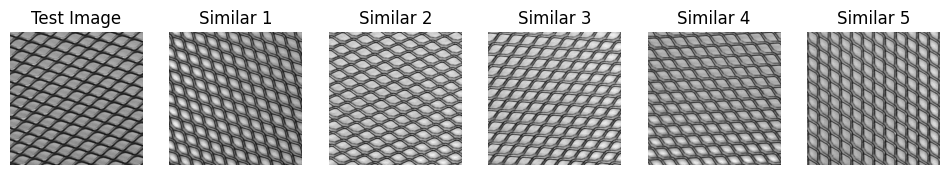


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/grid/test/good/018.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/grid/train/good/253.png
 - /kaggle/working/mvtec_ad/grid/train/good/134.png
 - /kaggle/working/mvtec_ad/grid/train/good/119.png
 - /kaggle/working/mvtec_ad/grid/train/good/133.png
 - /kaggle/working/mvtec_ad/grid/train/good/180.png


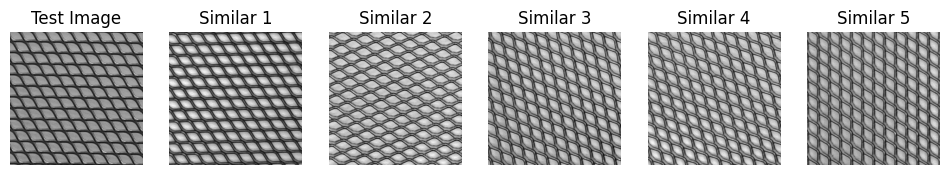


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/grid/test/good/012.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/grid/train/good/036.png
 - /kaggle/working/mvtec_ad/grid/train/good/069.png
 - /kaggle/working/mvtec_ad/grid/train/good/072.png
 - /kaggle/working/mvtec_ad/grid/train/good/164.png
 - /kaggle/working/mvtec_ad/grid/train/good/134.png


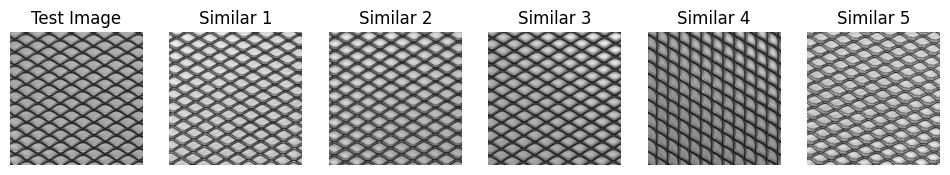


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/grid/test/good/020.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/grid/train/good/046.png
 - /kaggle/working/mvtec_ad/grid/train/good/078.png
 - /kaggle/working/mvtec_ad/grid/train/good/008.png
 - /kaggle/working/mvtec_ad/grid/train/good/135.png
 - /kaggle/working/mvtec_ad/grid/train/good/134.png


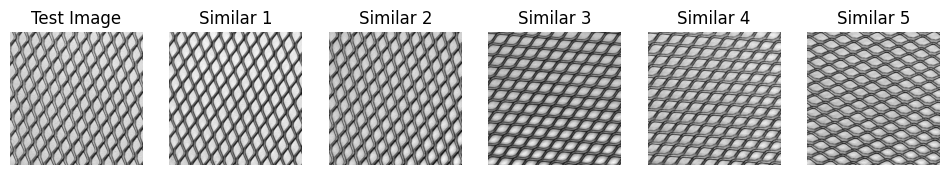


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/grid/test/good/007.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/grid/train/good/066.png
 - /kaggle/working/mvtec_ad/grid/train/good/125.png
 - /kaggle/working/mvtec_ad/grid/train/good/215.png
 - /kaggle/working/mvtec_ad/grid/train/good/119.png
 - /kaggle/working/mvtec_ad/grid/train/good/135.png


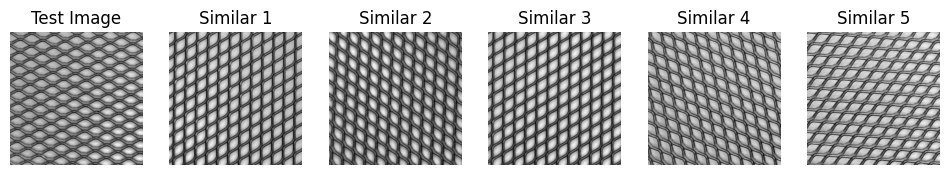


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/grid/test/good/000.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/grid/train/good/107.png
 - /kaggle/working/mvtec_ad/grid/train/good/060.png
 - /kaggle/working/mvtec_ad/grid/train/good/210.png
 - /kaggle/working/mvtec_ad/grid/train/good/012.png
 - /kaggle/working/mvtec_ad/grid/train/good/074.png


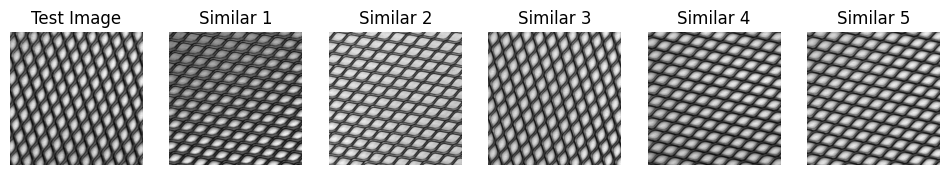


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/grid/test/good/017.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/grid/train/good/051.png
 - /kaggle/working/mvtec_ad/grid/train/good/181.png
 - /kaggle/working/mvtec_ad/grid/train/good/067.png
 - /kaggle/working/mvtec_ad/grid/train/good/134.png
 - /kaggle/working/mvtec_ad/grid/train/good/260.png


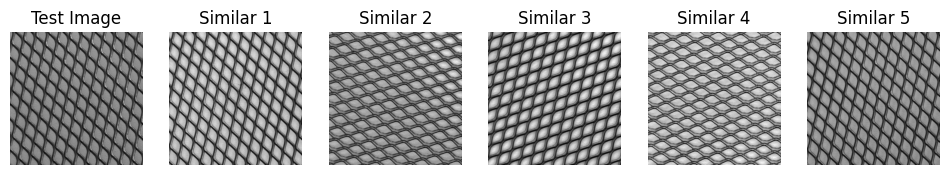


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/grid/test/good/006.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/grid/train/good/058.png
 - /kaggle/working/mvtec_ad/grid/train/good/013.png
 - /kaggle/working/mvtec_ad/grid/train/good/057.png
 - /kaggle/working/mvtec_ad/grid/train/good/134.png
 - /kaggle/working/mvtec_ad/grid/train/good/135.png


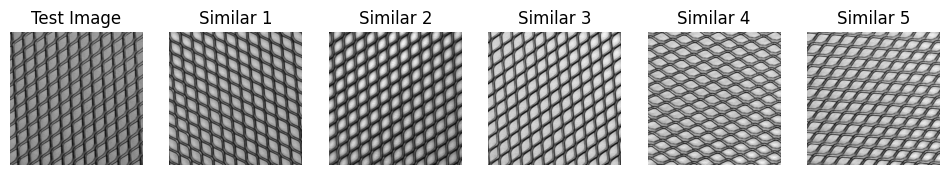


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/grid/test/good/005.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/grid/train/good/190.png
 - /kaggle/working/mvtec_ad/grid/train/good/053.png
 - /kaggle/working/mvtec_ad/grid/train/good/062.png
 - /kaggle/working/mvtec_ad/grid/train/good/119.png
 - /kaggle/working/mvtec_ad/grid/train/good/135.png


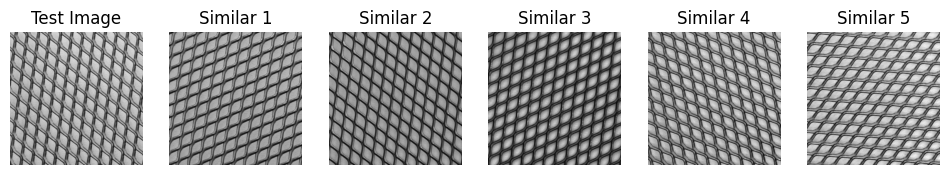


--------------------------------------------------

Test Image: /kaggle/working/mvtec_ad/grid/test/good/016.png
Top 5 similar images:
 - /kaggle/working/mvtec_ad/grid/train/good/171.png
 - /kaggle/working/mvtec_ad/grid/train/good/035.png
 - /kaggle/working/mvtec_ad/grid/train/good/137.png
 - /kaggle/working/mvtec_ad/grid/train/good/148.png
 - /kaggle/working/mvtec_ad/grid/train/good/101.png


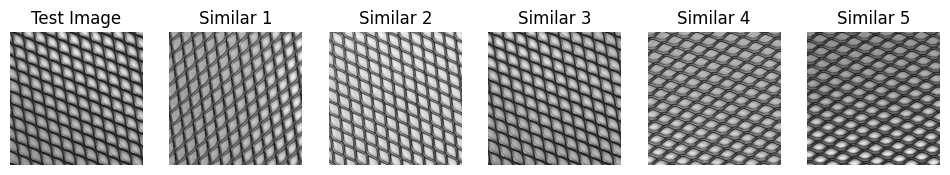


--------------------------------------------------



In [34]:
import os
import numpy as np
from PIL import Image
from sklearn.metrics.pairwise import cosine_similarity
import matplotlib.pyplot as plt

# Define dataset path for Kaggle
dataset_path = '/kaggle/working/mvtec_ad/grid'  # Use your provided dataset path

def extract_features(images_path):
    features = []
    image_files = []
    for img_name in os.listdir(images_path):
        img_path = os.path.join(images_path, img_name)
        if img_name.lower().endswith((".png", ".jpg", ".jpeg", ".bmp", ".tiff")):
            try:
                img = Image.open(img_path).convert("L")  # Convert to grayscale
                img_resized = img.resize((64, 64))  # Resize to 64x64
                img_array = np.array(img_resized).flatten()  # Flatten the image to 1D array
                features.append(img_array)
                image_files.append(img_path)
            except Exception as e:
                print(f"Error processing image {img_path}: {e}")
                continue
    return np.array(features), image_files

def find_similar_images_for_directory(test_images_path, features, image_files, top_n=5):
    test_results = {}
    for img_name in os.listdir(test_images_path):
        img_path = os.path.join(test_images_path, img_name)
        if img_name.lower().endswith((".png", ".jpg", ".jpeg", ".bmp", ".tiff")):
            try:
                input_image = Image.open(img_path).convert("L")
                input_image_resized = input_image.resize((64, 64))  # Resize to 64x64
                input_features = np.array(input_image_resized).flatten().reshape(1, -1)
                
                # Compute cosine similarity between the test image and training set
                similarities = cosine_similarity(input_features, features).flatten()
                similar_indices = similarities.argsort()[-top_n:][::-1]
                
                similar_images = [image_files[i] for i in similar_indices]
                test_results[img_path] = similar_images
            except Exception as e:
                print(f"Error processing test image {img_path}: {e}")
                continue
    return test_results

def display_similar_images(test_results):
    if not test_results:
        print("No similar images found to display.")
        return
    
    for test_image, similar_images in test_results.items():
        # Print paths for clarity
        print(f"Test Image: {test_image}")
        print("Top 5 similar images:")
        for img_path in similar_images:
            print(f" - {img_path}")
        
        # Display the test image and similar images
        plt.figure(figsize=(12, 2))
        
        # Display the test image
        test_img = Image.open(test_image)
        plt.subplot(1, 6, 1)
        plt.imshow(test_img, cmap='gray')
        plt.axis('off')
        plt.title("Test Image")
        
        # Display each similar image
        for i, img_path in enumerate(similar_images):
            similar_img = Image.open(img_path)
            plt.subplot(1, 6, i + 2)
            plt.imshow(similar_img, cmap='gray')
            plt.axis('off')
            plt.title(f"Similar {i+1}")
        
        plt.show()
        print("\n" + "-" * 50 + "\n")  # Separator for readability

# Load images and extract features from the training data
train_images_path = os.path.join(dataset_path, "train/good")  # Modify if needed
features, image_files = extract_features(train_images_path)
print(f"Extracted features from {len(image_files)} training images.\n")

# Specify path to test images and display similar images
test_images_path = os.path.join(dataset_path, "test/good")  # Modify if needed
similar_images_results = find_similar_images_for_directory(test_images_path, features, image_files)
display_similar_images(similar_images_results)
